# Memristive Reservoir Computing

In [1]:
%matplotlib inline

In [2]:
from __future__ import division

In [3]:
import numpy as np
import scipy as sp
import scipy.integrate as spint
import matplotlib.pyplot as plt
import memristive_reservoir as memres
import numpy.random as nprand
from sklearn.linear_model import Ridge

### Network Structures

In [4]:
# Two Network structures of interest are a mean-field like ER graph
# and a planar graph.  Inputs are weighted by a random vector.

n = 36
p = 0.16

Adj_ER = memres.create_adj_ER_G(n, p)

OmegaA_ER = memres.cycle_projector(Adj_ER)
OmegaB_ER = memres.vertex_projector(Adj_ER)
m_ER = OmegaA_ER.shape[0]
voltage_input_ER = np.dot(OmegaA_ER, np.random.rand(m_ER))
current_input_ER = np.dot(OmegaB_ER, np.random.rand(m_ER))

w0_ER = np.random.rand(m_ER)

# Gives a network of approximately 100 memristors
# A 8x8 cubic lattice will give a comparable network
# size.  Note that the boundaries are not periodic

lattice_shape = (8, 8)

Adj_cubic = memres.create_adj_cubic_2d(lattice_shape, undirected=False, xbias=0.5, ybias=0.5)
OmegaA_cubic = memres.cycle_projector(Adj_cubic)
OmegaB_cubic = memres.vertex_projector(Adj_cubic)
m_cubic = OmegaA_cubic.shape[0]
voltage_input_cubic = np.dot(OmegaA_cubic, np.random.rand(m_cubic))
current_input_cubic = np.dot(OmegaB_cubic, np.random.rand(m_cubic))

w0_cubic = np.random.rand(m_cubic)


## Test Problems

### Correlated Noise

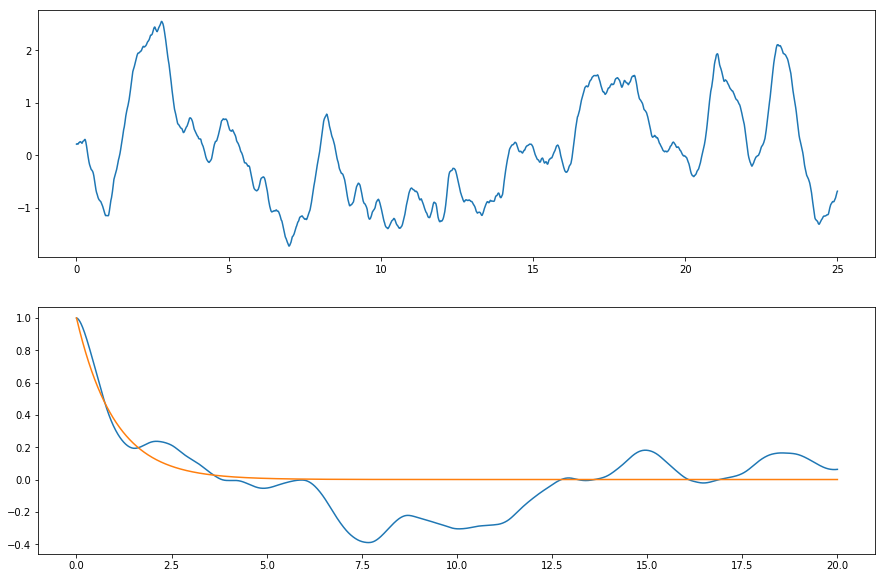

In [5]:
# We can generate noise with an approximate autocorrelation
# function by filtering delta correlated gaussian noise.
# We generate the gaussian noise on a timescale much faster
# than our filter.

# The signal is normalized to have an autocorrelation R(0) = 1
# We can see that the 2-sided exponential filter must hav a timescale
# of t/2 to give an autocorrelation with a timescale of t

t_final = 25

tstep_fast = 1e-3
N_tsteps = int(t_final / tstep_fast)+1

noise_times = np.linspace(0, t_final, N_tsteps)
source_noise = np.random.randn(N_tsteps)

exp_filter = np.concatenate((np.flipud(np.exp(-2*noise_times)), np.exp(-2*noise_times)))

filtered_noise = np.array([np.dot(exp_filter[i:i+N_tsteps], source_noise)*tstep_fast for i in range(N_tsteps)])

#We can downsample to a timescale 10x faster than the filter
DS = 10
filtered_noise = filtered_noise[::DS]
noise_times = noise_times[::DS]
tstep_ds = DS*tstep_fast
N_times = len(filtered_noise)

noise_variance = np.dot(filtered_noise, filtered_noise)/N_times
filtered_noise = filtered_noise / np.sqrt(noise_variance)

def noise_func(t):
    return np.interp(t, noise_times, filtered_noise)

def noise_voltage_source_ER(t):
    return voltage_input_ER*noise_func(t)

def noise_current_source_ER(t):
    return current_input_ER*noise_func(t)

def noise_voltage_source_cubic(t):
    return voltage_input_cubic*noise_func(t)

def noise_current_source_cubic(t):
    return current_input_cubic*noise_func(t)

overlap = int(N_times/5)

auto_corr = np.array([np.dot(filtered_noise[:i], filtered_noise[-i:])/N_times for i in range(overlap, N_times)])
auto_corr = np.flipud(auto_corr)
auto_corr_times = tstep_ds* np.arange(N_times-overlap)

fig, ax = plt.subplots(2, 1, figsize=(15, 10))
ax[0].plot(noise_times, filtered_noise)
ax[1].plot(auto_corr_times, auto_corr)
ax[1].plot(auto_corr_times, np.exp(-1*auto_corr_times))

### Mackey Glass

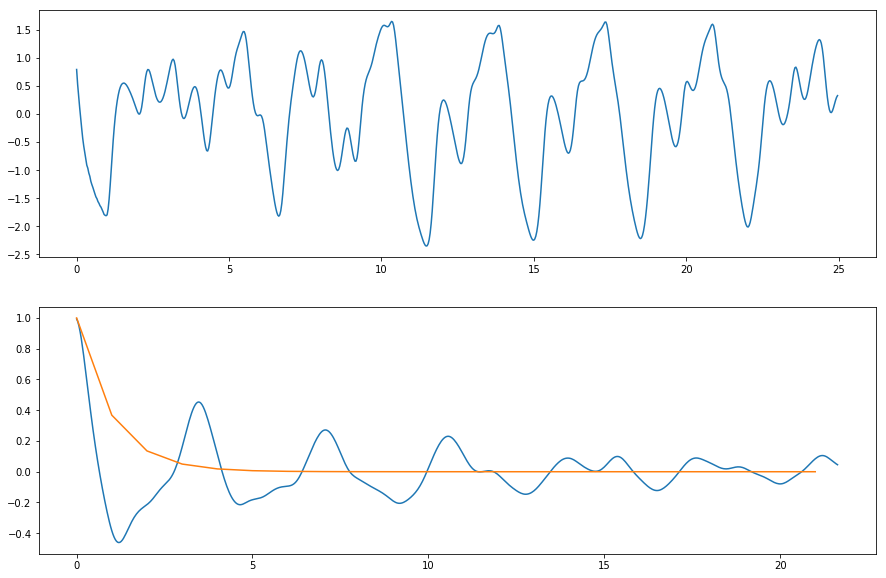

In [6]:
# The Mackey glass is a nonlinear delay differential equation.  After generating
# the data is centered and the variance normalized to 1.  The timescale is adjusted
# such that the autocorrelation function has a timescale of approx. 1.  If parameters
# of the simulation are changed, the timescale also has to be adjusted.

import collections
import numpy as np


def mackey_glass(time, dt, tau=30, seed=None):
    '''
    mackey_glass(sample_len=1000, tau=17, seed = None, n_samples = 1) -> input
    Generate the Mackey Glass time-series. Parameters are:
        - time: the number of timesteps
        - tau: delay of the MG - system. Commonly used values are tau=17 (mild 
          chaos) and tau=30 (moderate chaos). Default is 17.
        - seed: to seed the random generator, can be used to generate the same
          timeseries at each invocation.
    '''

    history_len = int(tau / dt)
    # Initial conditions for the history of the system
    timeseries = 1.2
    
    if seed is not None:
        np.random.seed(seed)


    history = collections.deque(1.2 * np.ones(history_len) + 0.2 * \
                                (np.random.rand(history_len) - 0.5))
    # Preallocate the array for the time-series
    inp = np.zeros((time,))
        
    for timestep in range(time):
        for _ in range(int(1/dt)):
            xtau = history.popleft()
            history.append(timeseries)
            timeseries = history[-1] + (0.2 * xtau / (1.0 + xtau ** 10) - \
                            0.1 * history[-1]) * dt
        inp[timestep] = timeseries

    return inp

time = 750

t_scale = 30
mg_series = mackey_glass(time, 0.1)

mg_series = mg_series - np.mean(mg_series)
variance = np.dot(mg_series, mg_series)/len(mg_series)
mg_series = mg_series/np.sqrt(variance)

mg_times = np.arange(time)/t_scale

def MG_func(t):
    return np.interp(t, mg_times, mg_series)

def MG_voltage_source_ER(t):
    return voltage_input_ER*MG_func(t)

def MG_current_source_ER(t):
    return current_input_ER*MG_func(t)

def MG_voltage_source_cubic(t):
    return voltage_input_cubic*MG_func(t)

def MG_current_source_cubic(t):
    return current_input_cubic*MG_func(t)

overlap=100


auto_corr = np.array([np.dot(mg_series[:i], mg_series[-i:])/time for i in range(overlap, time)])
auto_corr = np.flipud(auto_corr)
auto_corr_times = np.arange(time-overlap)/t_scale

fig, ax = plt.subplots(2, 1, figsize=(15, 10))

ax[0].plot(mg_times, mg_series)
ax[1].plot(auto_corr_times, auto_corr)
ax[1].plot(np.arange((time-overlap)/t_scale), np.exp(-np.arange((time-overlap)/t_scale)))

## Training

The model includes disorder in the value of $\alpha$.  Disorder in the other parameters does not seem to have a marked effect.  At the moment, the best results have come from exponentially distributed values of $\alpha$.

#### Filtered Noise: without random $\alpha$

In [8]:
alpha = 1
beta = 0.5
chi = 0.5

dwdt = memres.CaravelliEqn(noise_voltage_source_ER, OmegaA_ER, alpha, beta, chi)

times, traj = memres.integrate_Caravelli(dwdt, (0, t_final), w0_ER)

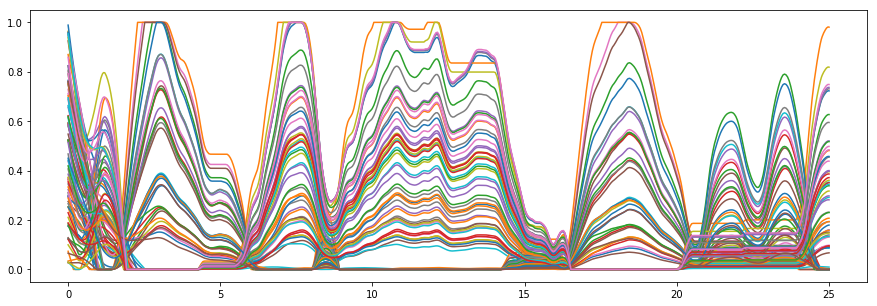

In [9]:
fig, ax = plt.subplots(figsize=(15, 5))

for idx in range(m_ER):
    ax.plot(times, traj[idx, :])

In [10]:
# We ignore dynamics during the transient
transient = 10
# We will train on the next interval
training_tfinal = 20
# and test on the remainder

# preparing training data
training_mask = np.logical_and(times > transient, times < training_tfinal)

training_times = times[training_mask]
training_traj = traj[:, training_mask]

output = noise_func(training_times)

clf = Ridge(alpha=0.001)
clf.fit(training_traj.T, output) 

Ridge(alpha=0.001, copy_X=True, fit_intercept=True, max_iter=None,
   normalize=False, random_state=None, solver='auto', tol=0.001)

In [11]:
reconstruction = clf.predict(training_traj.T)


def MSE_reservoir(training_data, reconstruction, times):
    T = times[-1] - times[0]
    dt = times[1:] - times[:-1]
    squared_error = (reconstruction - training_data)**2
    squared_error_symm = (squared_error[:-1] + squared_error[1:])/2
    return np.dot(squared_error_symm, dt)/T

MSE_reservoir(output, reconstruction, training_times)

0.049297273916272817

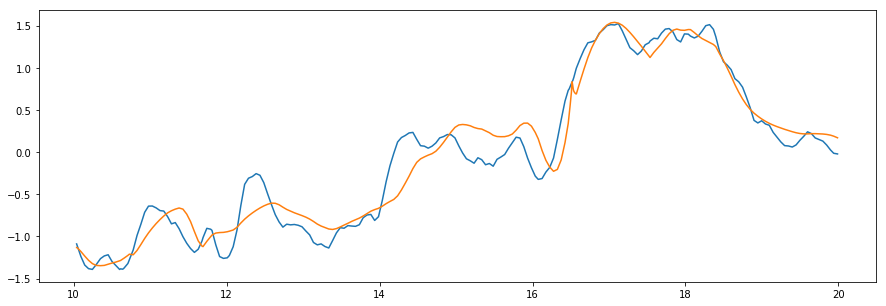

In [12]:
fig, ax = plt.subplots(figsize=(15, 5))

ax.plot(training_times, output)
ax.plot(training_times, reconstruction)

In [14]:
# Encapsulating the Training Procedure

def train_reservoir(source, output_func, OmegaA, alpha, beta, chi, t_final=25, transient=10, training_tfinal=20, plotting=True):
    '''
    Performs the simulation and fitting of a reservoir, returning
    the simulated trajectory, trained regressor, and
    MSE of the training and extrapolation
    '''
    m = OmegaA.shape[0]
    
    dwdt = memres.CaravelliEqn(source, OmegaA, alpha, beta, chi)
    times, traj = memres.integrate_Caravelli(dwdt, (0, t_final), np.random.rand(m))
    
    training_mask = np.logical_and(times > transient, times < training_tfinal)
    training_times = times[training_mask]
    training_traj = traj[:, training_mask]
    training_output = output_func(training_times)

    clf = Ridge(alpha=0.001)
    clf.fit(training_traj.T, training_output)
    reconstruction = clf.predict(training_traj.T)
    
    MSE_train = MSE_reservoir(training_output, reconstruction, training_times)
    
    extrap_mask = times >= training_tfinal
    extrap_times = times[extrap_mask]
    extrap_traj = traj[:, extrap_mask]
    
    extrap_output = output_func(extrap_times)
    extrapolation = clf.predict(extrap_traj.T)
    
    MSE_extrap = MSE_reservoir(extrap_output, extrapolation, extrap_times)
    
    if plotting:
        fig, ax = plt.subplots(2, 1, figsize=(15, 10))
        for idx in range(m):
            ax[0].plot(times, traj[idx, :])
        ax[1].plot(training_times, training_output)
        ax[1].plot(training_times, reconstruction)
        ax[1].plot(extrap_times, extrap_output)
        ax[1].plot(extrap_times, extrapolation)
        
    return times, traj, clf, MSE_train, MSE_extrap

#### Filtered Noise: with random $\alpha$

Training MSE: 0.00319144380171
Extrapolated MSE: 0.17270927125


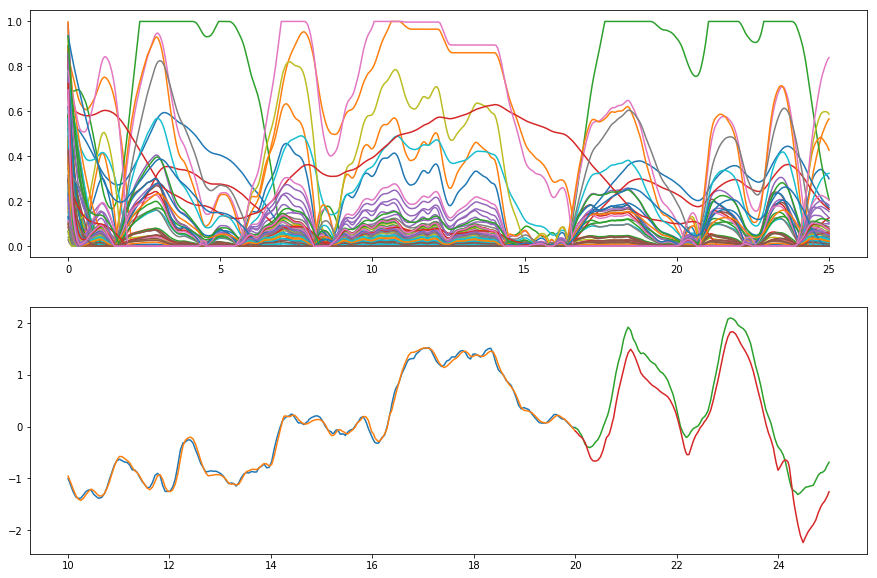

In [15]:
alpha = np.random.exponential(scale=8, size=(m_ER,))
beta = 0.5
chi = 0.5

times, traj, clf, MSE_train, MSE_extrap = train_reservoir(noise_voltage_source_ER, 
                                            noise_func, OmegaA_ER, alpha, beta, chi)

print "Training MSE:", str(MSE_train)
print "Extrapolated MSE:", str(MSE_extrap)

#### Mackey Glass

Training MSE: 0.0023949474705
Extrapolated MSE: 0.0138586021011


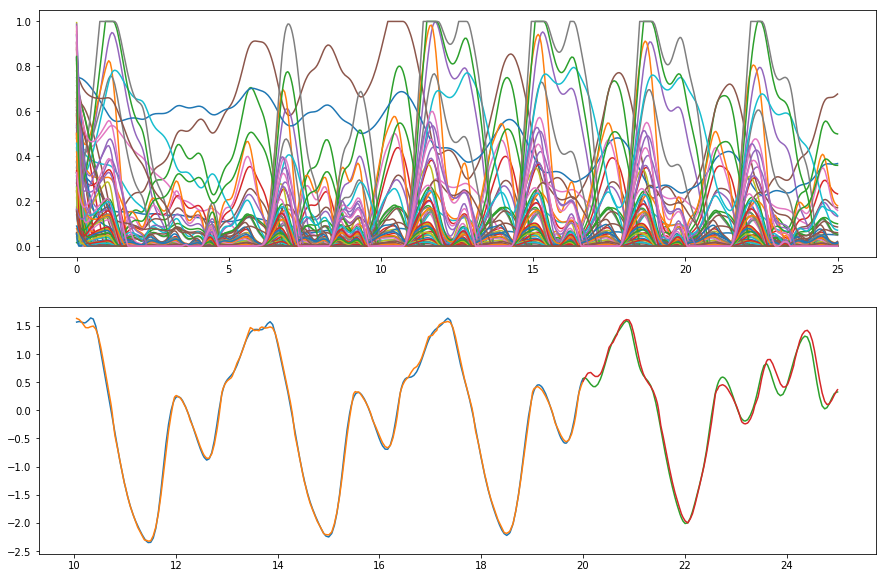

In [16]:
alpha = np.random.exponential(scale=8, size=(m_ER,))
beta = 0.5
chi = 0.5

times, traj, clf, MSE_train, MSE_extrap = train_reservoir(MG_voltage_source_ER, 
                                            MG_func, OmegaA_ER, alpha, beta, chi)

print "Training MSE:", str(MSE_train)
print "Extrapolated MSE:", str(MSE_extrap)

## Network Structure

Comparisons between an Erdos Renyi graph and cubic lattice (with random memristor directions) do not indicate a strong influence on performance.

Training MSE: 0.0018937448876
Extrapolated MSE: 0.0737886920964


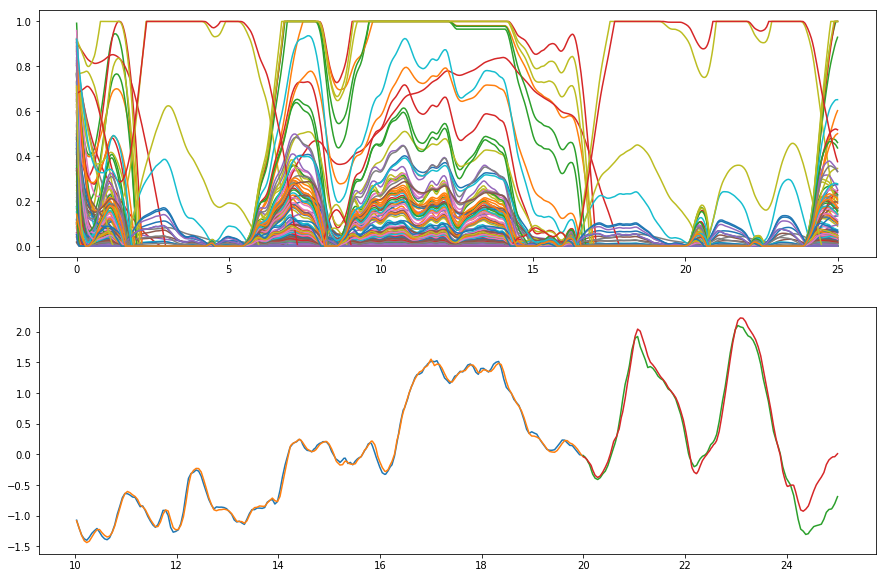

In [17]:
def noise_voltage_source_cubic(t):
    return voltage_input_cubic*noise_func(t)

alpha = np.random.exponential(scale=8, size=(m_cubic,))
beta = 0.5
chi = 0.5

times, traj, clf, MSE_train, MSE_extrap = train_reservoir(noise_voltage_source_cubic, 
                                            noise_func, OmegaA_cubic, alpha, beta, chi)

print "Training MSE:", str(MSE_train)
print "Extrapolated MSE:", str(MSE_extrap)

Training MSE: 0.00274248603767
Extrapolated MSE: 0.0167189582192


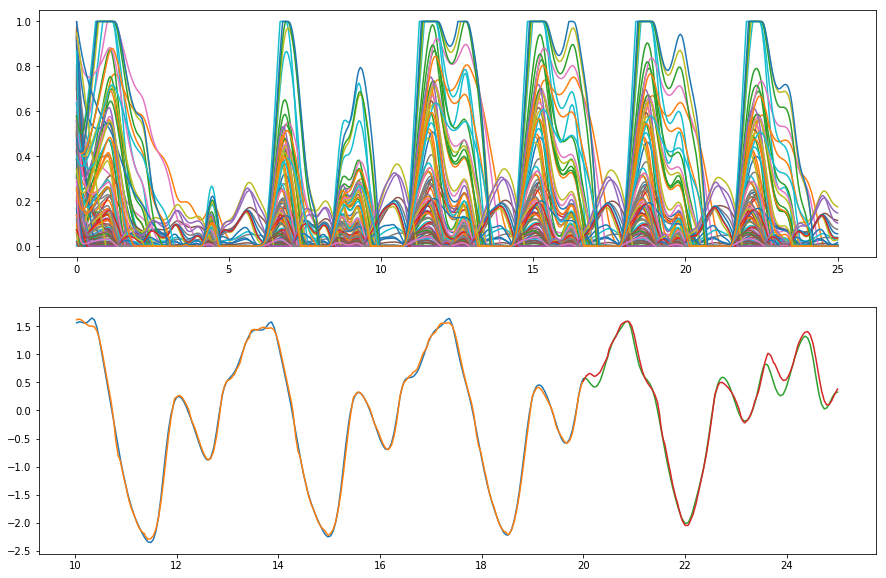

In [18]:

def MG_voltage_source_cubic(t):
    return voltage_input_cubic*MG_func(t)

alpha = np.random.exponential(scale=8, size=(m_cubic,))
beta = 0.5
chi = 0.5

times, traj, clf, MSE_train, MSE_extrap = train_reservoir(MG_voltage_source_cubic, 
                                            MG_func, OmegaA_cubic, alpha, beta, chi)

print "Training MSE:", str(MSE_train)
print "Extrapolated MSE:", str(MSE_extrap)

## Tuning $\alpha$ $\beta$ and $\chi$

We can run parameter sweeps across these to determine which regions are most conducive to our problems

In [129]:
# def noise_voltage_source_cubic(t):
#     return voltage_input_cubic*noise_func(t)


# alpha_list = [0.5, 1, 2, 4, 8, 16, 32]
# num_alpha = len(alpha_list)
# beta_list = [0.025, 0.05, 0.1, 0.2, 0.5, 1, 2, 4]
# num_beta = len(beta_list)
# chi_list = [0.05, 0.1, 0.3, 0.5, 0.7, 0.9, 0.95]
# num_chi = len(chi_list)

# MSE_training_tuning = np.zeros((num_alpha, num_beta, num_chi), dtype='float')
# MSE_extrap_tuning = np.zeros((num_alpha, num_beta, num_chi), dtype='float')

# for a_idx, alpha_scale in enumerate(alpha_list):
#     for b_idx, beta in enumerate(beta_list):
#         for c_idx, chi in enumerate(chi_list):
            
#             alpha = np.random.exponential(scale=alpha_scale, size=(m_cubic,))

#             times, traj, clf, MSE_training, MSE_extrap = train_reservoir(noise_voltage_source_cubic, 
#                                             noise_func, OmegaA_cubic, alpha, beta, chi, plotting=False)

#             MSE_training_tuning[a_idx, b_idx, c_idx] = MSE_training
#             MSE_extrap_tuning[a_idx, b_idx, c_idx] = MSE_extrap

# np.savez('MSE_parameter_sweep_L8cubic_filterednoise_expanded', alpha_list, beta_list, chi_list, MSE_training_tuning, MSE_extrap_tuning)

In [26]:
files = np.load('MSE_parameter_sweep_L8cubic_filterednoise_expanded.npz')

alpha_list = files['arr_0']
beta_list = files['arr_1']
chi_list = files['arr_2']
MSE_training_tuning = files['arr_3']
MSE_extrap_tuning = files['arr_4']

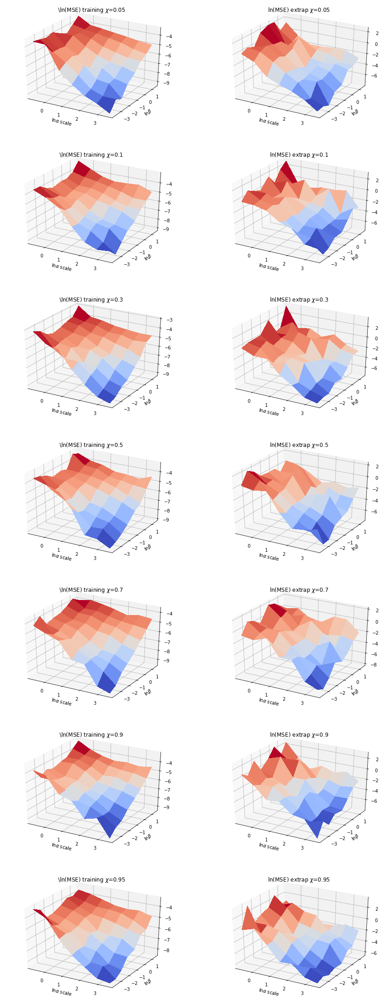

In [30]:
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import cm

fig = plt.figure(figsize=(15, 40))

A, B = np.meshgrid(alpha_list, beta_list)
num_chi = len(chi_list)

for idx, chi in enumerate(chi_list):
    ax = fig.add_subplot(7, 2, idx*2+1, projection='3d')
    
    surf = ax.plot_surface(np.log(A), np.log(B), np.log(MSE_training_tuning[:, :, idx].squeeze().T), rstride=1, cstride=1,
                        cmap=cm.coolwarm, linewidth=0, antialiased=False)

    ax.set_xlabel(r'$\ln\alpha$ scale')

    ax.set_ylabel(r'$\ln\beta$')
    ax.set_title('\ln(MSE) training $\chi$='+str(chi))
    
    #ax.view_init(azim=90)
    
    ax = fig.add_subplot(7, 2, idx*2+2, projection='3d')
    
    surf = ax.plot_surface(np.log(A), np.log(B), np.log(MSE_extrap_tuning[:, :, idx].squeeze().T), rstride=1, cstride=1,
                        cmap=cm.coolwarm, linewidth=0, antialiased=False)

    ax.set_xlabel(r'$\ln\alpha$ scale')

    ax.set_ylabel(r'$\ln\beta$')
    ax.set_title('ln(MSE) extrap $\chi$='+str(chi))
    
    #ax.view_init(azim=90)

We see fairly uniformly that the best results come from a large $\alpha$ scale and the smallest $\beta$ (which is the same as a large signal magnitude.

Training MSE: 7.07771092275e-05
Extrapolated MSE: 0.00501279518945


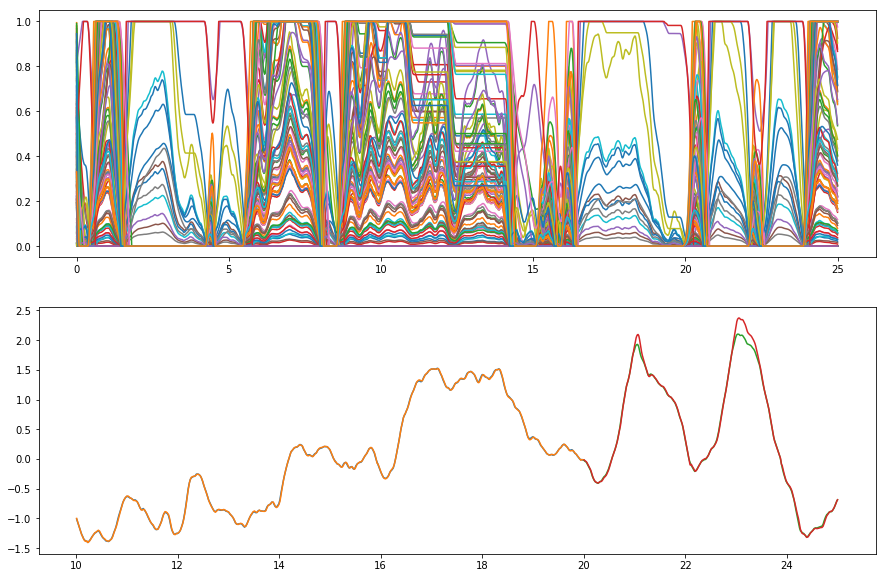

In [31]:
def noise_voltage_source_cubic(t):
    return voltage_input_cubic*noise_func(t)

alpha = np.random.exponential(scale=32, size=(m_cubic,))
beta = 0.025
chi = 0.3

times, traj, clf, MSE_train, MSE_extrap = train_reservoir(noise_voltage_source_cubic, 
                                            noise_func, OmegaA_cubic, alpha, beta, chi)

print "Training MSE:", str(MSE_train)
print "Extrapolated MSE:", str(MSE_extrap)

## Memory Capacity

In this parameter range, we can look at memory capacity as a function of $\tau$, the time delay of the signal. 

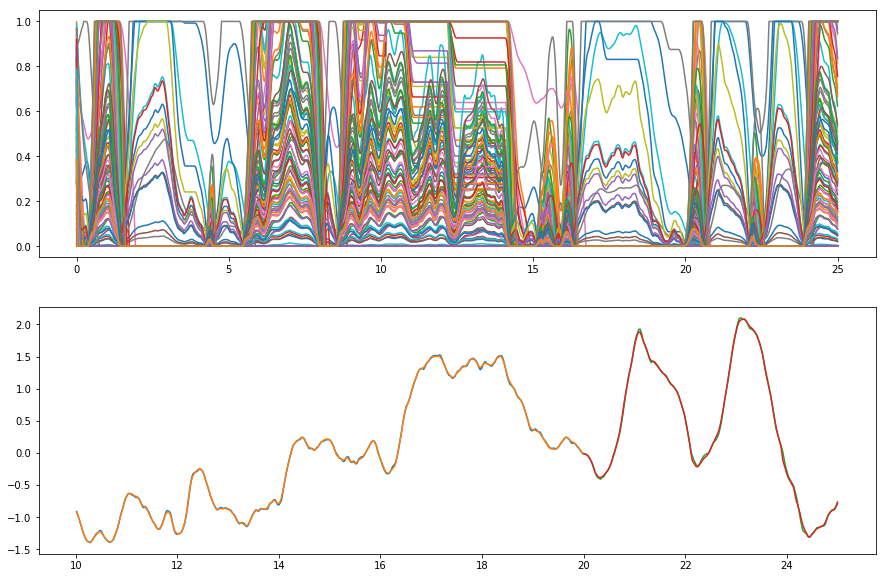

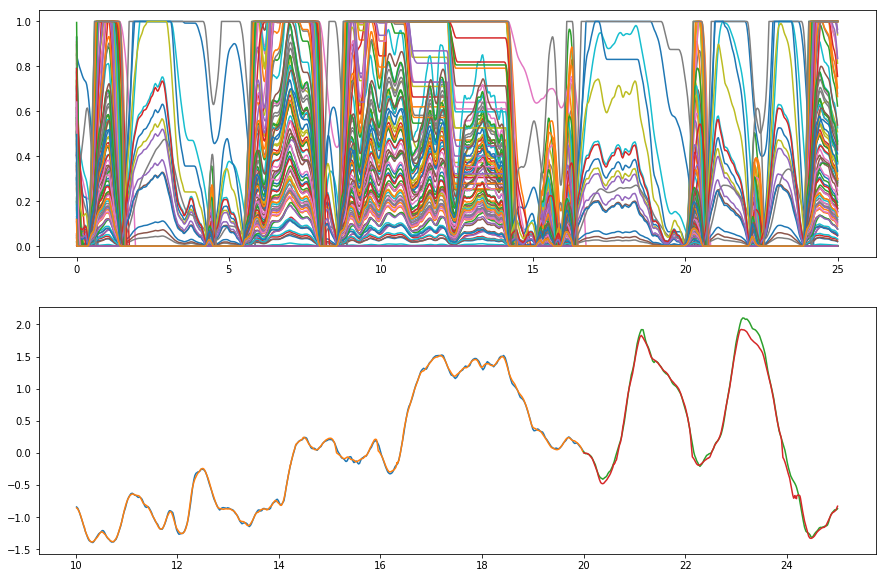

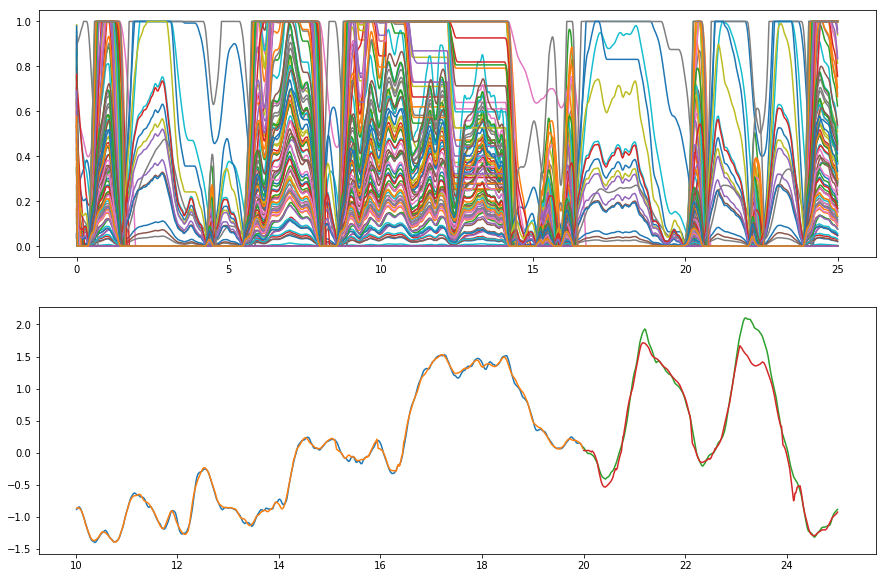

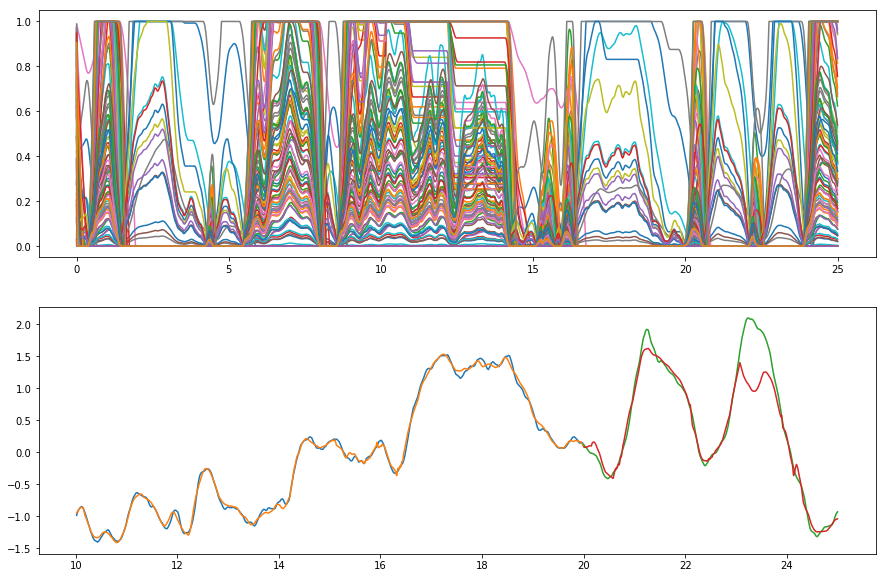

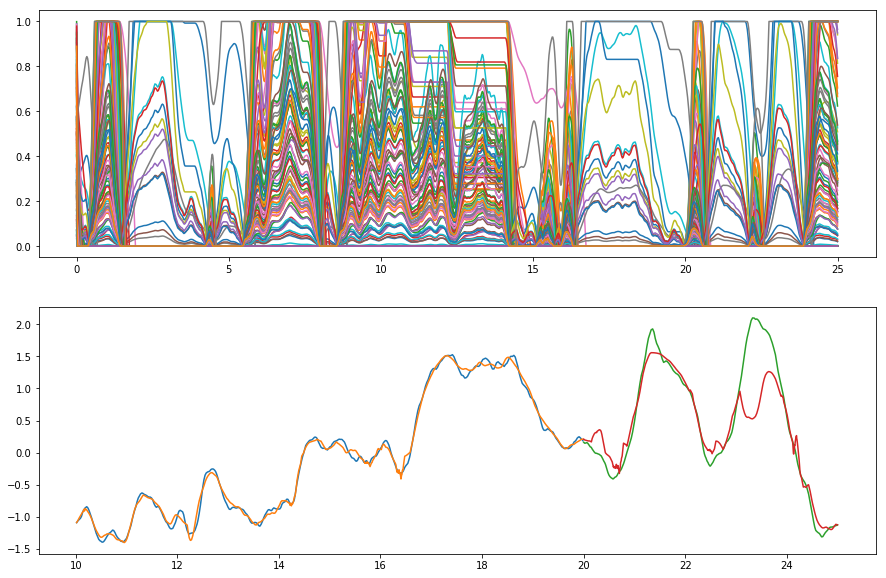

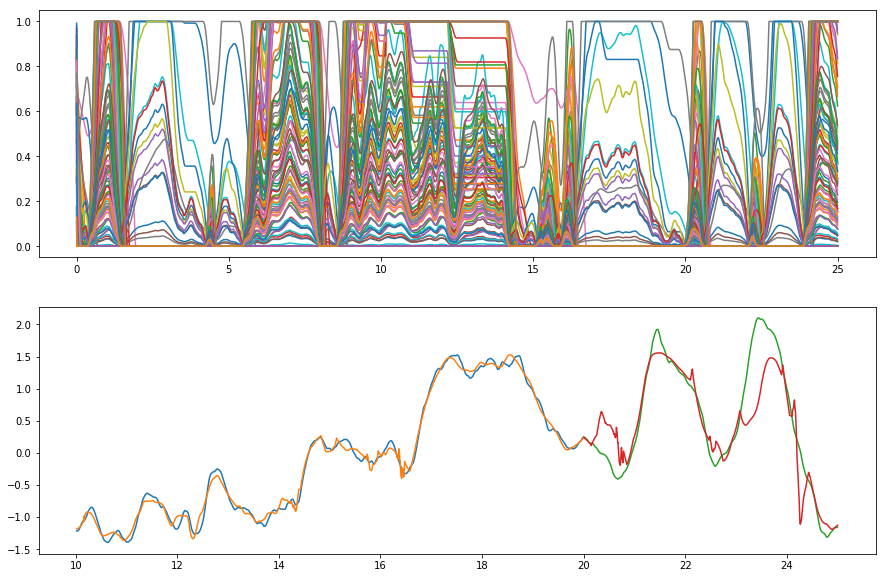

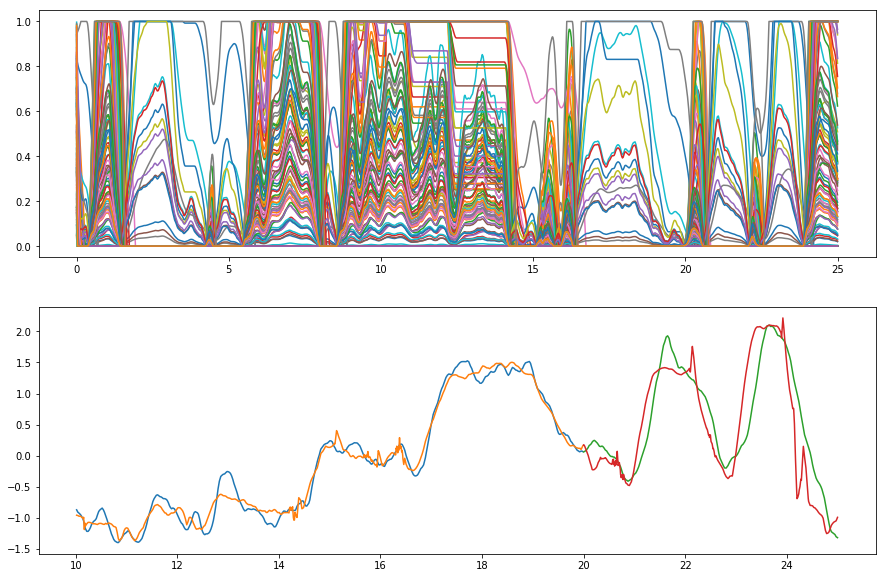

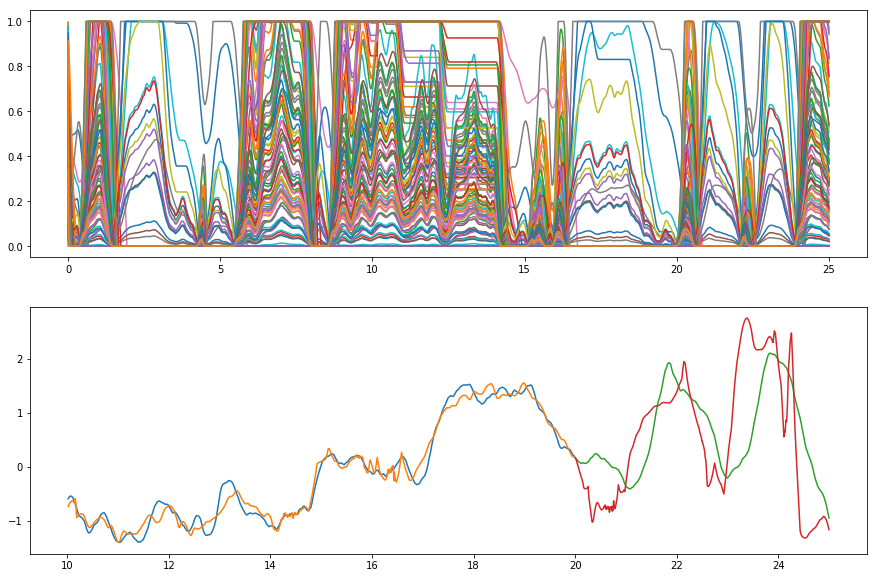

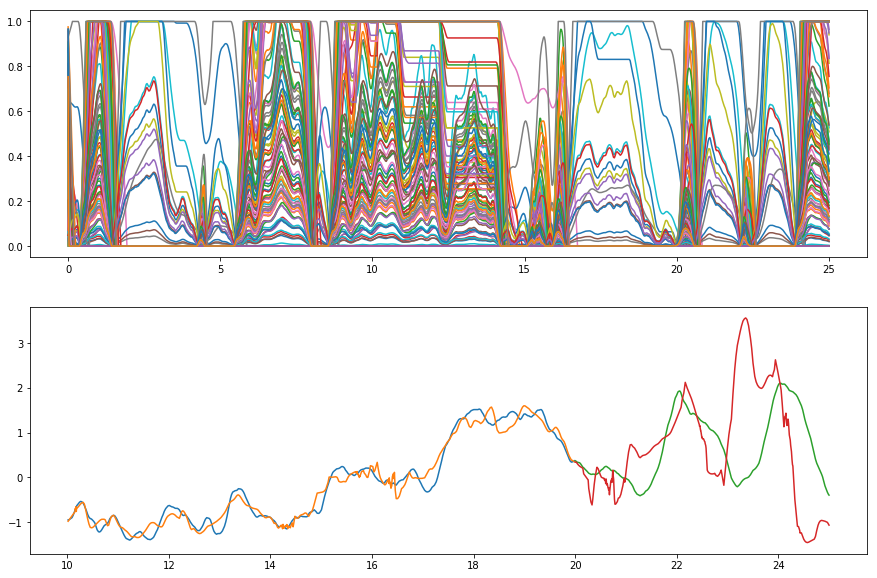

In [50]:
alpha = np.random.exponential(scale=32, size=(m_cubic,))
beta = 0.025
chi = 0.3

delays = [0.05, 0.1, 0.15, 0.2, 0.3, 0.4, 0.6, 0.8, 1.0]
MSE_delays_train = np.zeros_like(delays, dtype='float')
MSE_delays_extrap = np.zeros_like(delays, dtype='float')

for idx, tau in enumerate(delays):

    def delayed_noise(t):
        return noise_func(t-tau)

    times, traj, clf, MSE_train, MSE_extrap = train_reservoir(noise_voltage_source_cubic, 
                                            delayed_noise, OmegaA_cubic, alpha, beta, chi)
    
    MSE_delays_train[idx] = MSE_train
    MSE_delays_extrap[idx] = MSE_extrap
    
np.savez('Noise_delay_reconstruction.npz', delays=delays, MSE_delays_train=MSE_delays_train, MSE_delays_extrap=MSE_delays_extrap)

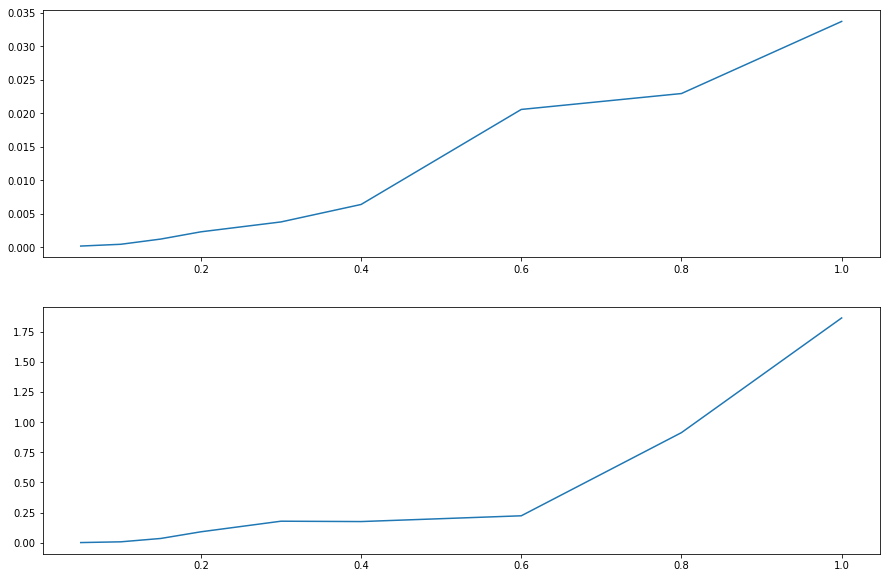

In [51]:
files = np.load('Noise_delay_reconstruction.npz')

delays = files['delays']
MSE_delays_train = files['MSE_delays_train']
MSE_delays_extrap = files['MSE_delays_extrap']

fig, ax = plt.subplots(2, 1, figsize=(15, 10))

ax[0].plot(delays, MSE_delays_train)

ax[1].plot(delays, MSE_delays_extrap)

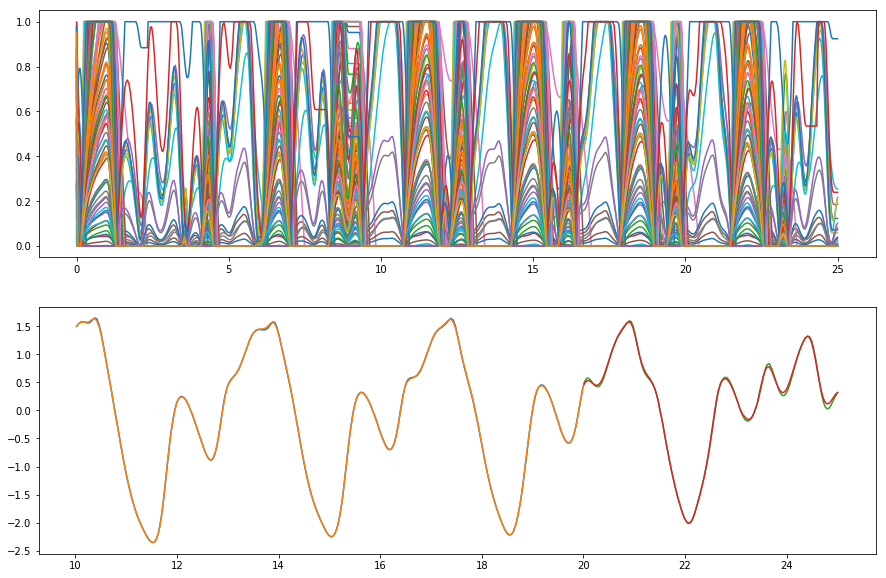

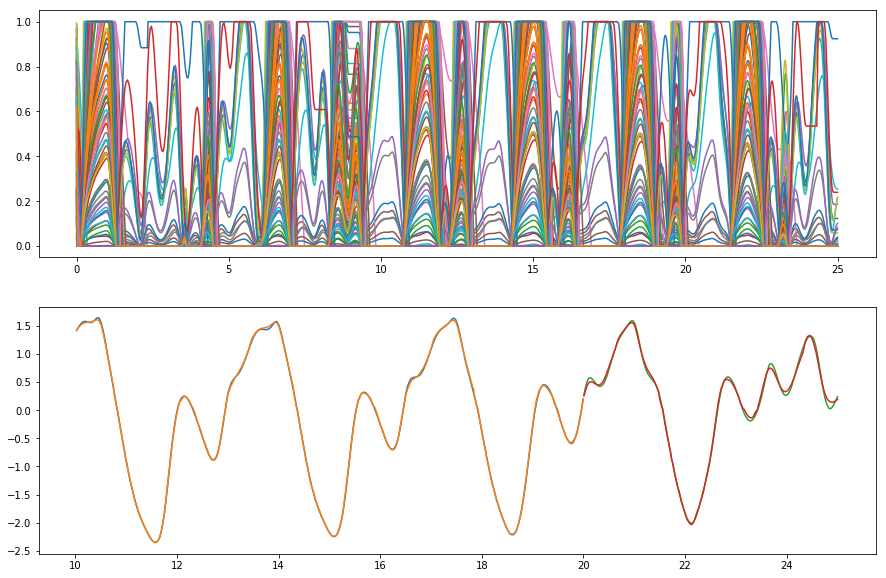

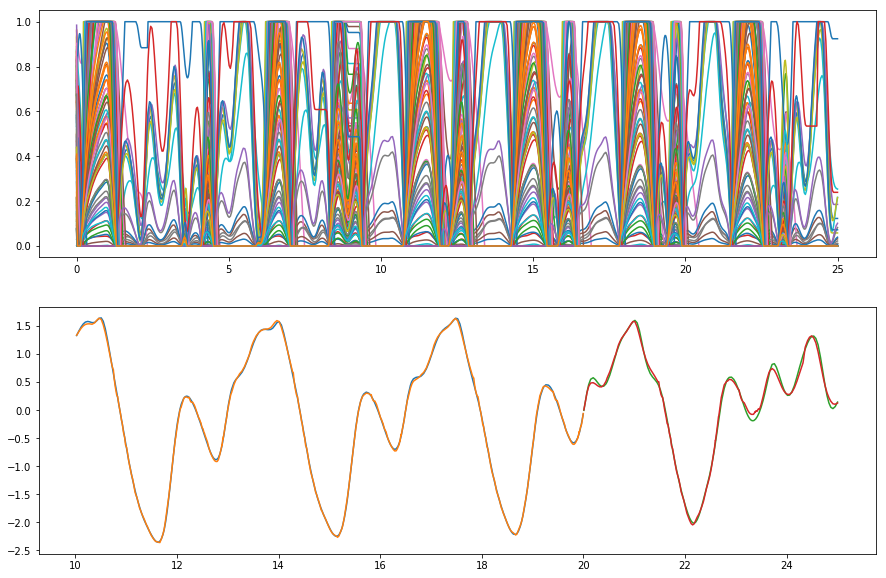

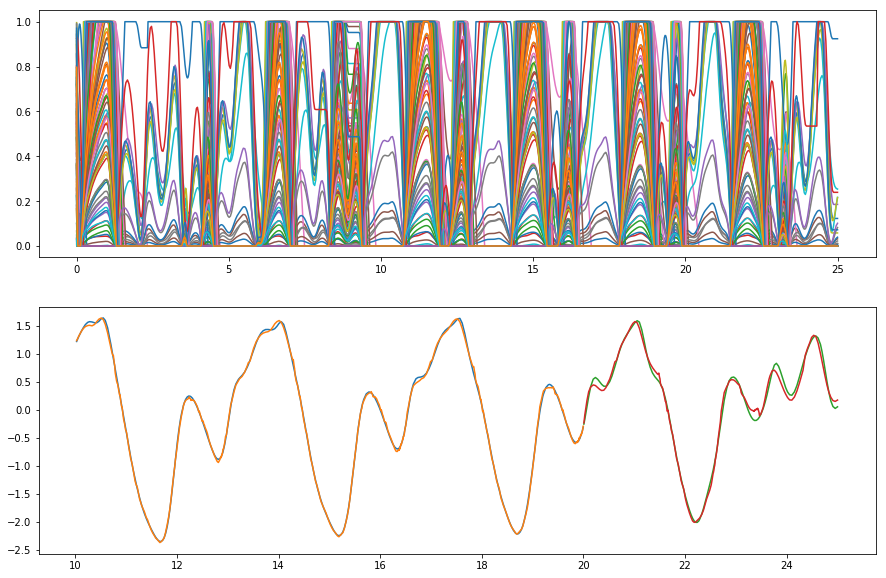

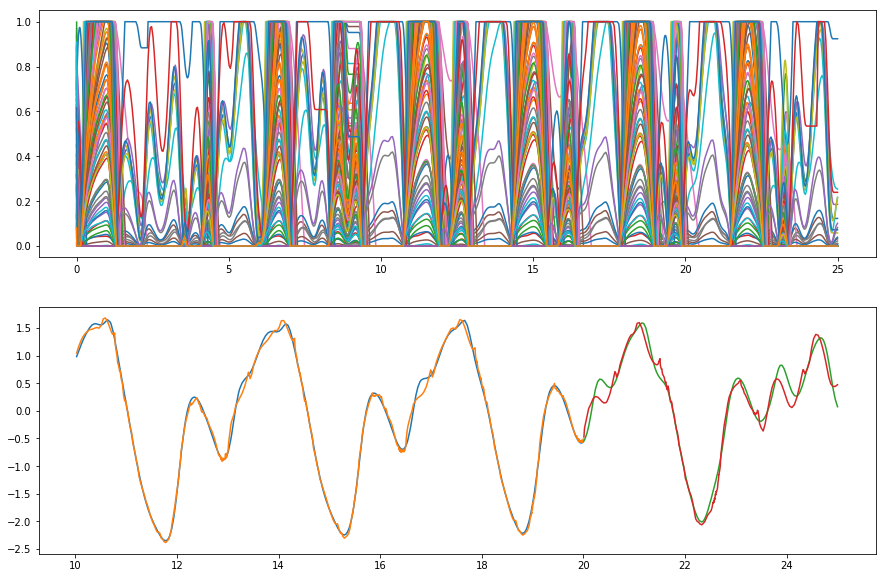

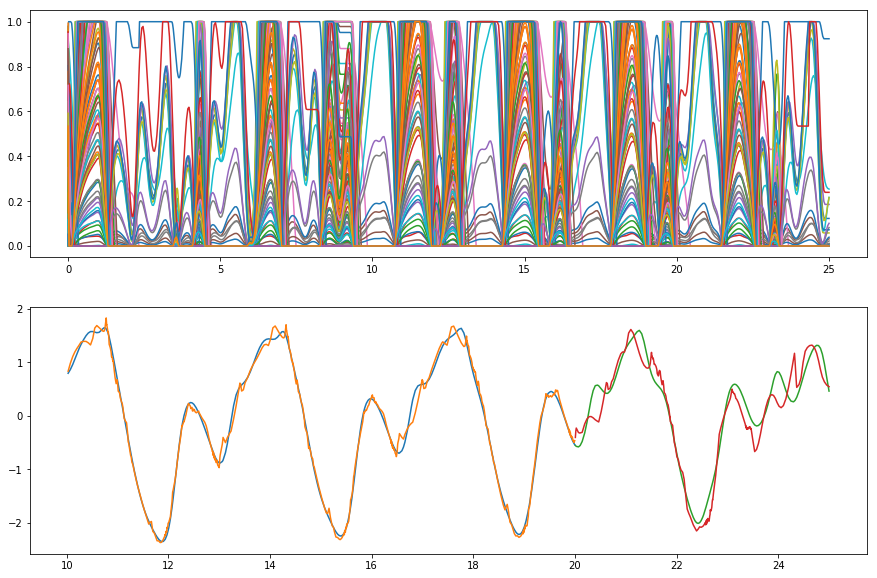

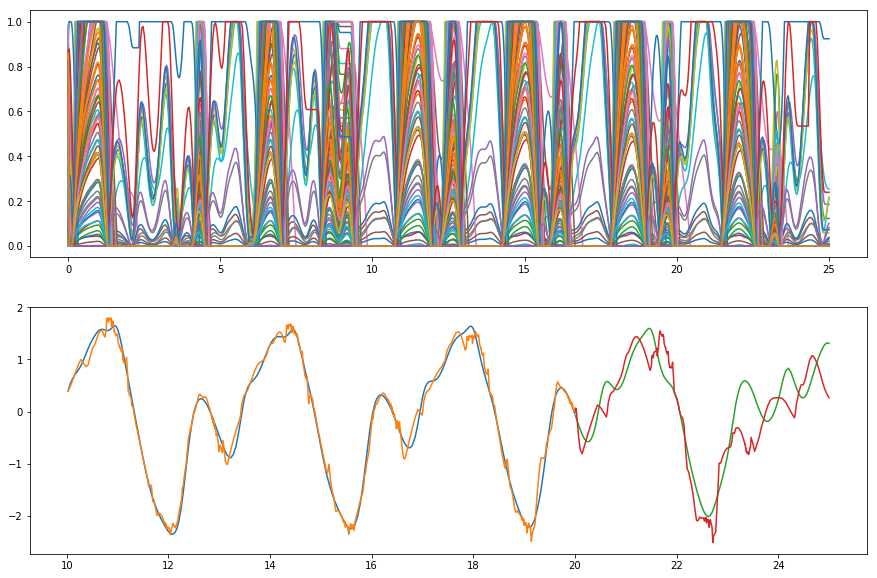

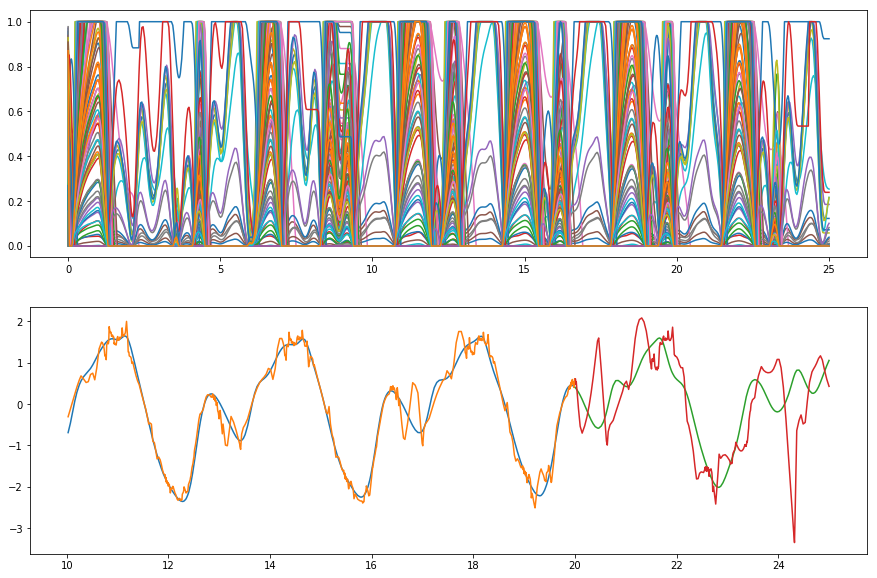

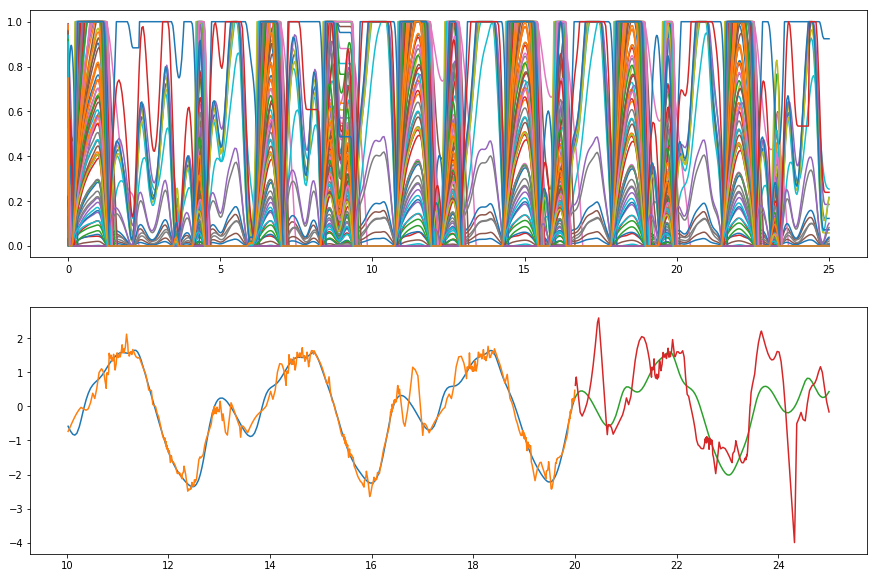

In [52]:
alpha = np.random.exponential(scale=32, size=(m_cubic,))
beta = 0.025
chi = 0.3

delays = [0.05, 0.1, 0.15, 0.2, 0.3, 0.4, 0.6, 0.8, 1.0]
MSE_delays_train = np.zeros_like(delays, dtype='float')
MSE_delays_extrap = np.zeros_like(delays, dtype='float')

for idx, tau in enumerate(delays):

    def delayed_MG(t):
        return MG_func(t-tau)

    times, traj, clf, MSE_train, MSE_extrap = train_reservoir(MG_voltage_source_cubic, 
                                            delayed_MG, OmegaA_cubic, alpha, beta, chi)
    
    MSE_delays_train[idx] = MSE_train
    MSE_delays_extrap[idx] = MSE_extrap
    
np.savez('MG_delay_reconstruction.npz', delays=delays, MSE_delays_train=MSE_delays_train, MSE_delays_extrap=MSE_delays_extrap)

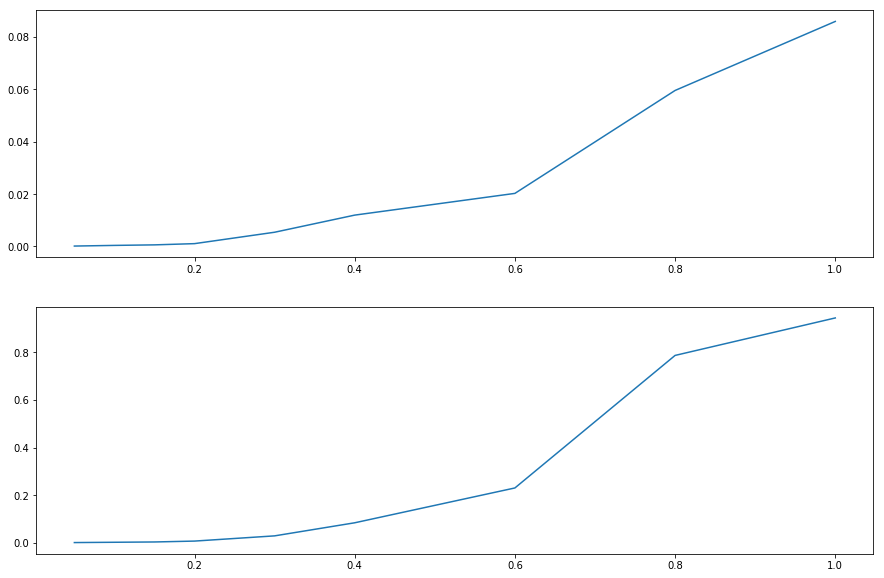

In [53]:
files = np.load('MG_delay_reconstruction.npz')

delays = files['delays']
MSE_delays_train = files['MSE_delays_train']
MSE_delays_extrap = files['MSE_delays_extrap']

fig, ax = plt.subplots(2, 1, figsize=(15, 10))

ax[0].plot(delays, MSE_delays_train)

ax[1].plot(delays, MSE_delays_extrap)

## Current Controls

Training MSE: 7.66003865874e-05
Extrapolated MSE: 0.000283620483647


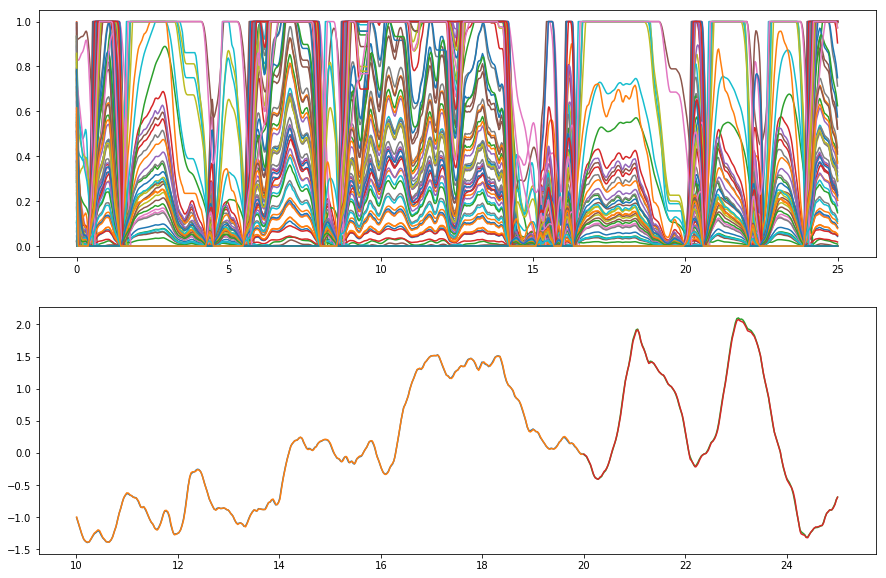

In [54]:
OmegaB_cubic = memres.vertex_projector(Adj_cubic)

current_input_cubic = np.dot(OmegaB_cubic, np.random.rand(m_cubic))

def noise_current_source_cubic(t):
    return current_input_cubic * noise_func(t)

times, traj, clf, MSE_train, MSE_extrap = train_reservoir(noise_current_source_cubic, 
                                            noise_func, OmegaA_cubic, alpha, beta, chi)

print "Training MSE:", str(MSE_train)
print "Extrapolated MSE:", str(MSE_extrap)

## Tuning for Current Controls

In [69]:

# alpha_list = [ 1, 2, 4, 8, 16, 32, 64]
# num_alpha = len(alpha_list)
# beta_list = [0.001, 0.0025, 0.005, 0.01, 0.025, 0.05, 0.1, 0.2, 0.5, 1]
# num_beta = len(beta_list)
# chi_list = [0.05, 0.1, 0.3, 0.5, 0.7, 0.9, 0.95]
# num_chi = len(chi_list)

# MSE_training_tuning = np.zeros((num_alpha, num_beta, num_chi), dtype='float')
# MSE_extrap_tuning = np.zeros((num_alpha, num_beta, num_chi), dtype='float')

# for a_idx, alpha_scale in enumerate(alpha_list):
#     for b_idx, beta in enumerate(beta_list):
#         for c_idx, chi in enumerate(chi_list):
            
#             alpha = np.random.exponential(scale=alpha_scale, size=(m_cubic,))

#             times, traj, clf, MSE_training, MSE_extrap = train_reservoir(noise_current_source_cubic, 
#                                             noise_func, OmegaA_cubic, alpha, beta, chi, plotting=False)

#             MSE_training_tuning[a_idx, b_idx, c_idx] = MSE_training
#             MSE_extrap_tuning[a_idx, b_idx, c_idx] = MSE_extrap

# np.savez('MSE_parameter_sweep_L8cubic_filterednoise_current_expanded', alpha_list, beta_list, chi_list, MSE_training_tuning, MSE_extrap_tuning)

In [70]:
files = np.load('MSE_parameter_sweep_L8cubic_filterednoise_current_expanded.npz')

alpha_list = files['arr_0']
beta_list = files['arr_1']
chi_list = files['arr_2']
MSE_training_tuning = files['arr_3']
MSE_extrap_tuning = files['arr_4']

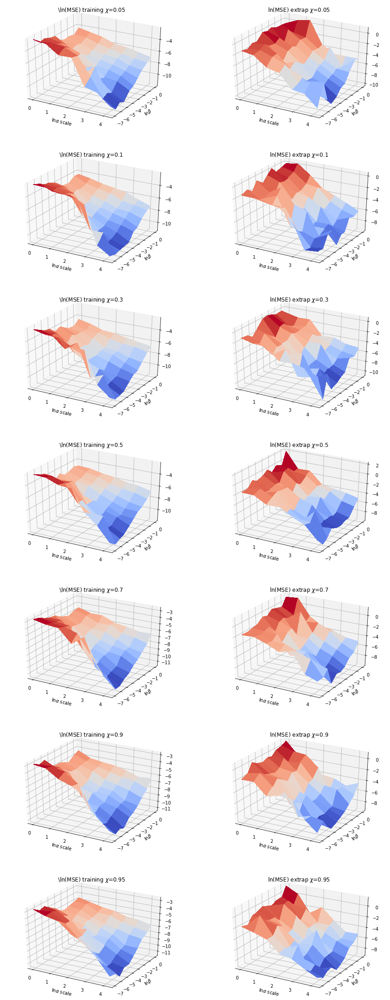

In [71]:
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import cm

fig = plt.figure(figsize=(15, 40))

A, B = np.meshgrid(alpha_list, beta_list)
num_chi = len(chi_list)

for idx, chi in enumerate(chi_list):
    ax = fig.add_subplot(7, 2, idx*2+1, projection='3d')
    
    surf = ax.plot_surface(np.log(A), np.log(B), np.log(MSE_training_tuning[:, :, idx].squeeze().T), rstride=1, cstride=1,
                        cmap=cm.coolwarm, linewidth=0, antialiased=False)

    ax.set_xlabel(r'$\ln\alpha$ scale')

    ax.set_ylabel(r'$\ln\beta$')
    ax.set_title('\ln(MSE) training $\chi$='+str(chi))
    
    #ax.view_init(azim=90)
    
    ax = fig.add_subplot(7, 2, idx*2+2, projection='3d')
    
    surf = ax.plot_surface(np.log(A), np.log(B), np.log(MSE_extrap_tuning[:, :, idx].squeeze().T), rstride=1, cstride=1,
                        cmap=cm.coolwarm, linewidth=0, antialiased=False)

    ax.set_xlabel(r'$\ln\alpha$ scale')

    ax.set_ylabel(r'$\ln\beta$')
    ax.set_title('ln(MSE) extrap $\chi$='+str(chi))
    
    #ax.view_init(azim=90)

### Memory in current controls

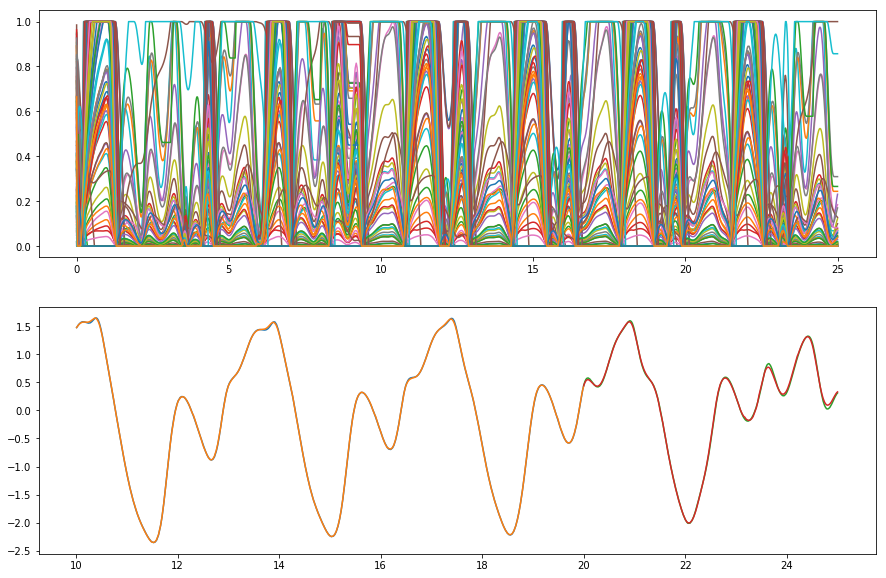

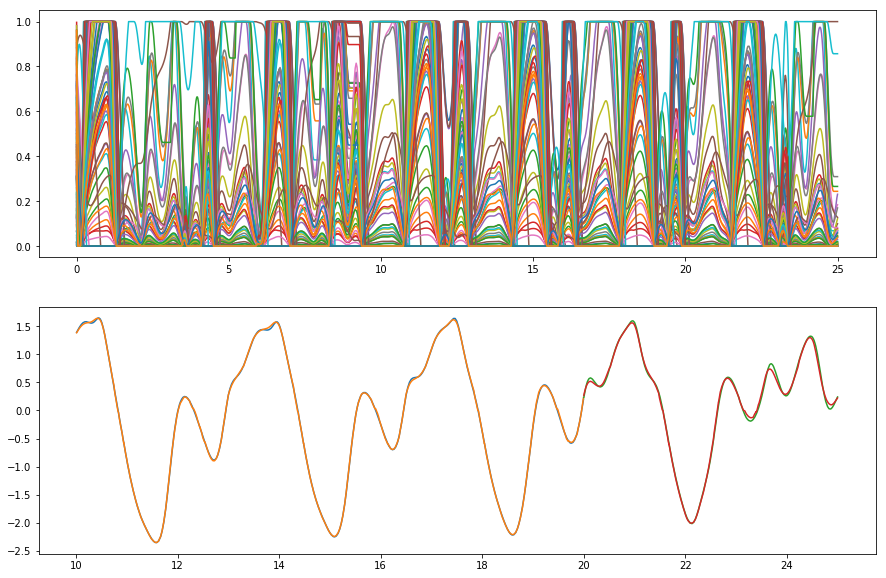

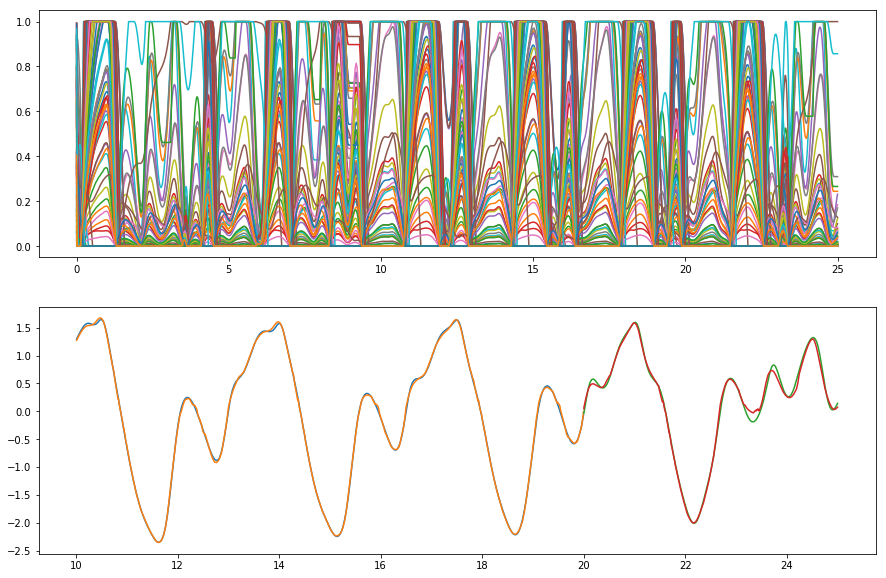

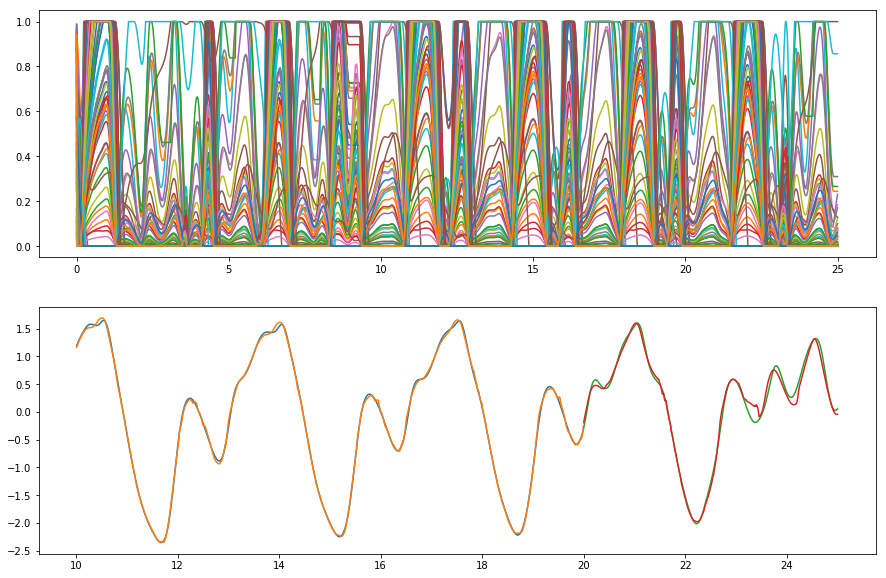

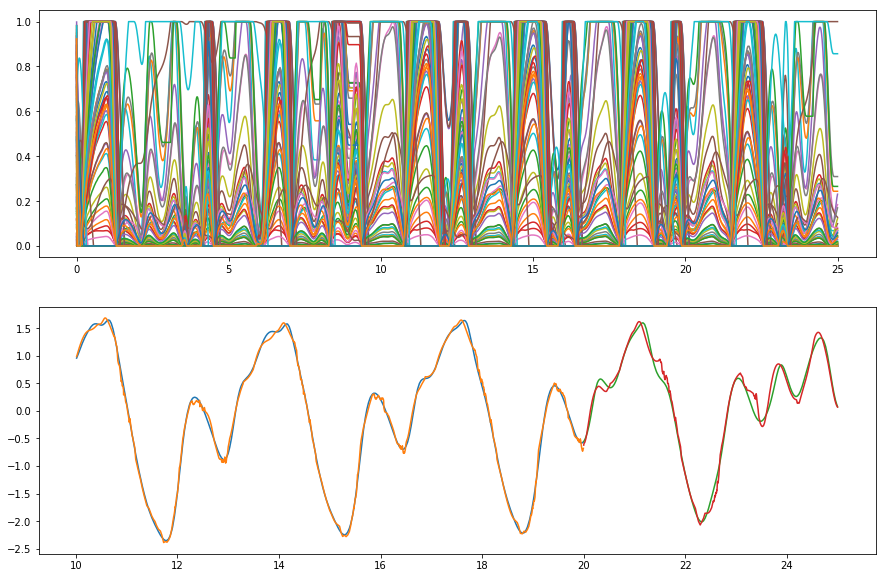

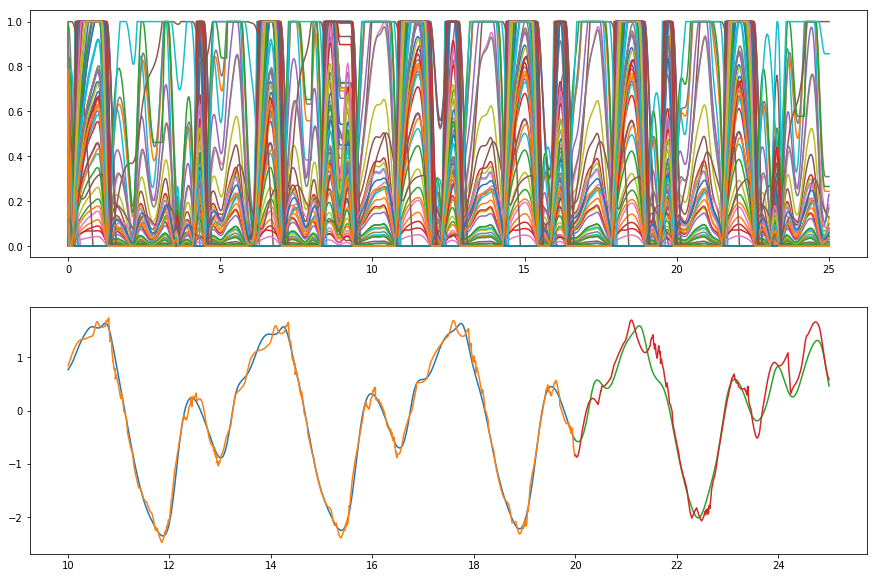

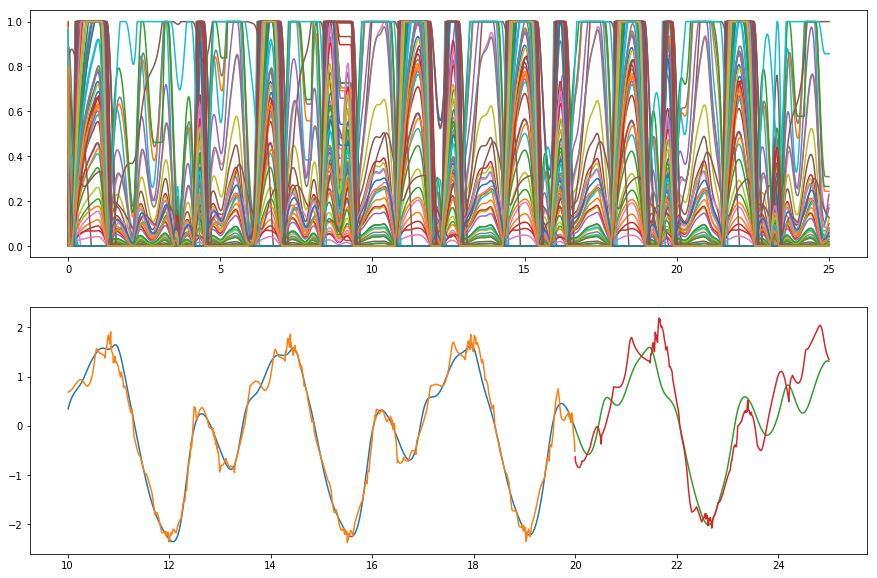

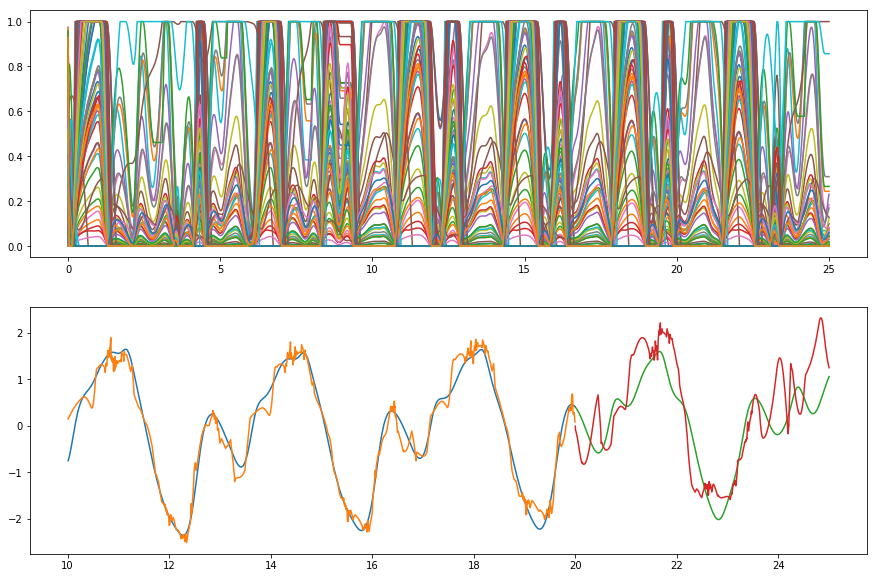

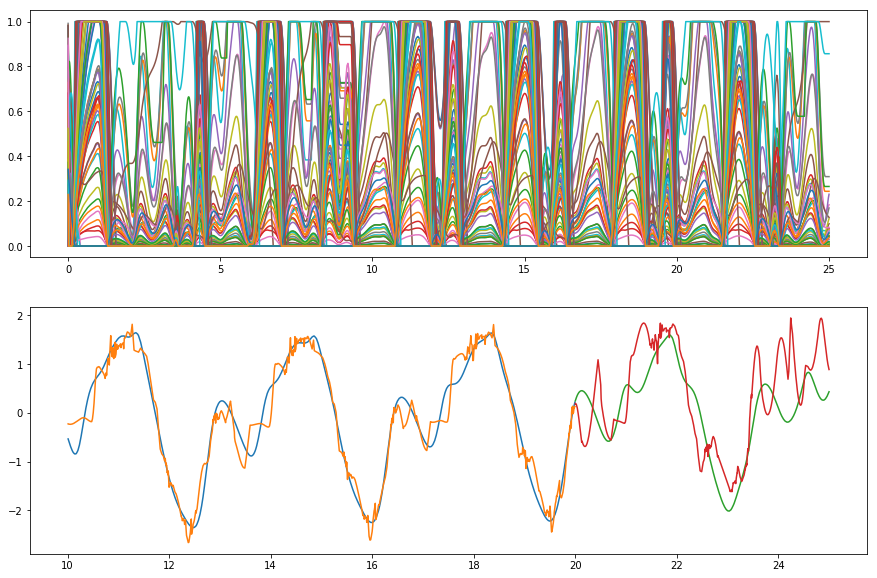

In [55]:
def MG_current_source_cubic(t):
    return current_input_cubic * MG_func(t)

alpha = np.random.exponential(scale=32, size=(m_cubic,))
beta = 0.025
chi = 0.3

delays = [0.05, 0.1, 0.15, 0.2, 0.3, 0.4, 0.6, 0.8, 1.0]
MSE_delays_train = np.zeros_like(delays, dtype='float')
MSE_delays_extrap = np.zeros_like(delays, dtype='float')

for idx, tau in enumerate(delays):

    def delayed_MG(t):
        return MG_func(t-tau)

    times, traj, clf, MSE_train, MSE_extrap = train_reservoir(MG_current_source_cubic, 
                                            delayed_MG, OmegaA_cubic, alpha, beta, chi)
    
    MSE_delays_train[idx] = MSE_train
    MSE_delays_extrap[idx] = MSE_extrap
    
np.savez('MG_delay_current_reconstruction.npz', delays=delays, MSE_delays_train=MSE_delays_train, MSE_delays_extrap=MSE_delays_extrap)

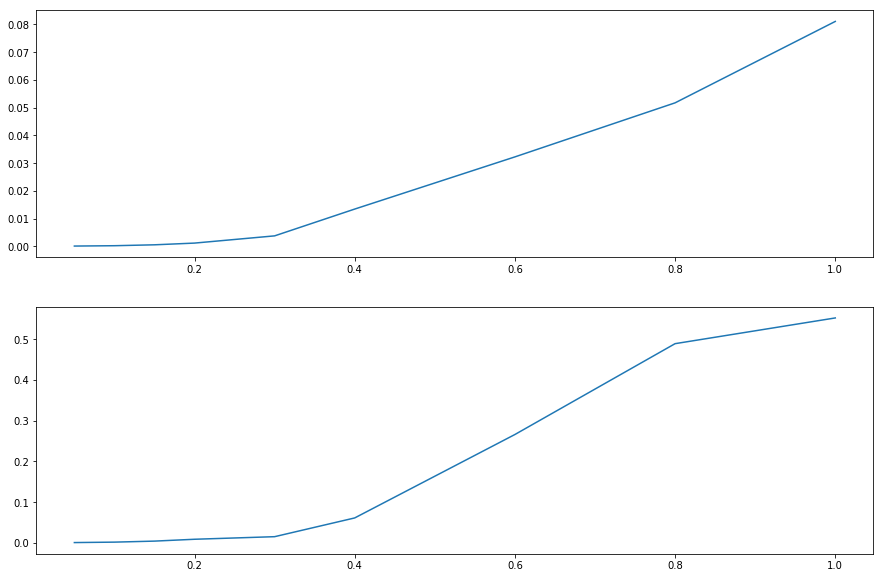

In [56]:
files = np.load('MG_delay_current_reconstruction.npz')

delays = files['delays']
MSE_delays_train = files['MSE_delays_train']
MSE_delays_extrap = files['MSE_delays_extrap']

fig, ax = plt.subplots(2, 1, figsize=(15, 10))

ax[0].plot(delays, MSE_delays_train)

ax[1].plot(delays, MSE_delays_extrap)

## Tuning for Memory

In [74]:

alpha_list = [ 1, 2, 4, 8, 16, 32, 64]
num_alpha = len(alpha_list)
beta_list = [0.001, 0.0025, 0.005, 0.01, 0.025, 0.05, 0.1, 0.2, 0.5, 1]
num_beta = len(beta_list)
chi_list = [0.05, 0.1, 0.3, 0.5, 0.7, 0.9, 0.95]
num_chi = len(chi_list)

MSE_training_tuning = np.zeros((num_alpha, num_beta, num_chi), dtype='float')
MSE_extrap_tuning = np.zeros((num_alpha, num_beta, num_chi), dtype='float')

tau = 1.
def delayed_noise(t):
    return noise_func(t-tau)
    
for a_idx, alpha_scale in enumerate(alpha_list):
    for b_idx, beta in enumerate(beta_list):
        for c_idx, chi in enumerate(chi_list):
            
            alpha = np.random.exponential(scale=alpha_scale, size=(m_cubic,))

            times, traj, clf, MSE_training, MSE_extrap = train_reservoir(noise_current_source_cubic, 
                                            delayed_noise, OmegaA_cubic, alpha, beta, chi, plotting=False)

            MSE_training_tuning[a_idx, b_idx, c_idx] = MSE_training
            MSE_extrap_tuning[a_idx, b_idx, c_idx] = MSE_extrap

np.savez('MSE_parameter_sweep_L8cubic_filterednoise_current_delay1', alpha_list, beta_list, chi_list, MSE_training_tuning, MSE_extrap_tuning)

In [75]:
files = np.load('MSE_parameter_sweep_L8cubic_filterednoise_current_delay1.npz')

alpha_list = files['arr_0']
beta_list = files['arr_1']
chi_list = files['arr_2']
MSE_training_tuning = files['arr_3']
MSE_extrap_tuning = files['arr_4']

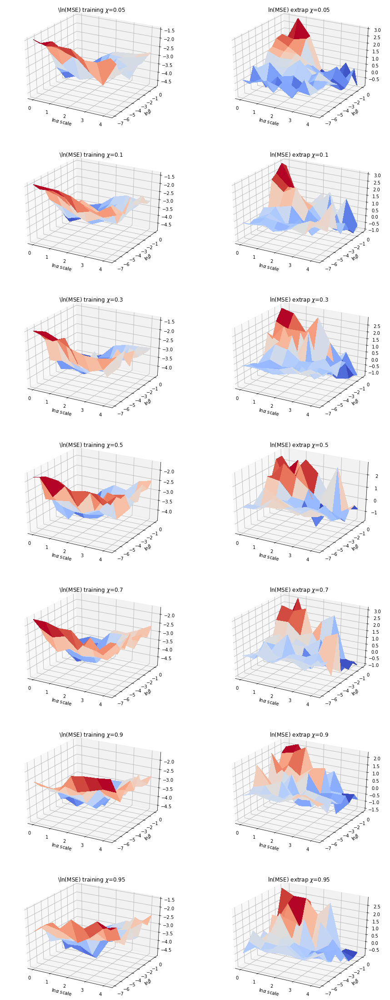

In [76]:
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import cm

fig = plt.figure(figsize=(15, 40))

A, B = np.meshgrid(alpha_list, beta_list)
num_chi = len(chi_list)

for idx, chi in enumerate(chi_list):
    ax = fig.add_subplot(7, 2, idx*2+1, projection='3d')
    
    surf = ax.plot_surface(np.log(A), np.log(B), np.log(MSE_training_tuning[:, :, idx].squeeze().T), rstride=1, cstride=1,
                        cmap=cm.coolwarm, linewidth=0, antialiased=False)

    ax.set_xlabel(r'$\ln\alpha$ scale')

    ax.set_ylabel(r'$\ln\beta$')
    ax.set_title('\ln(MSE) training $\chi$='+str(chi))
    
    #ax.view_init(azim=90)
    
    ax = fig.add_subplot(7, 2, idx*2+2, projection='3d')
    
    surf = ax.plot_surface(np.log(A), np.log(B), np.log(MSE_extrap_tuning[:, :, idx].squeeze().T), rstride=1, cstride=1,
                        cmap=cm.coolwarm, linewidth=0, antialiased=False)

    ax.set_xlabel(r'$\ln\alpha$ scale')

    ax.set_ylabel(r'$\ln\beta$')
    ax.set_title('ln(MSE) extrap $\chi$='+str(chi))
    
    #ax.view_init(azim=90)

## Nonlinear Reconstruction

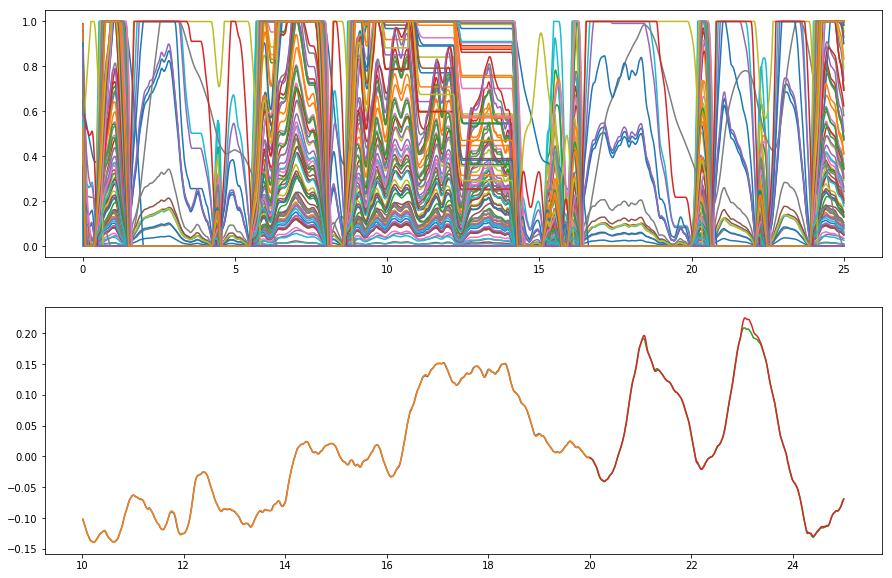

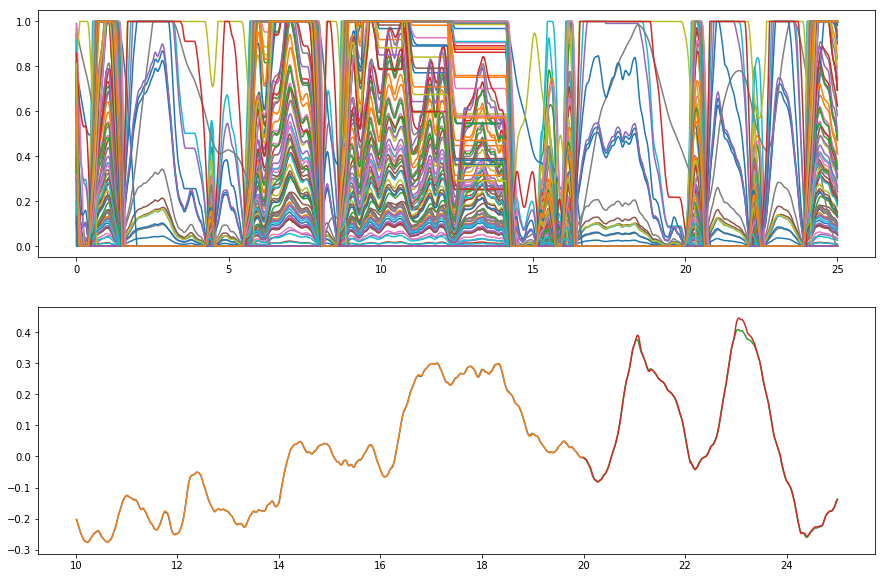

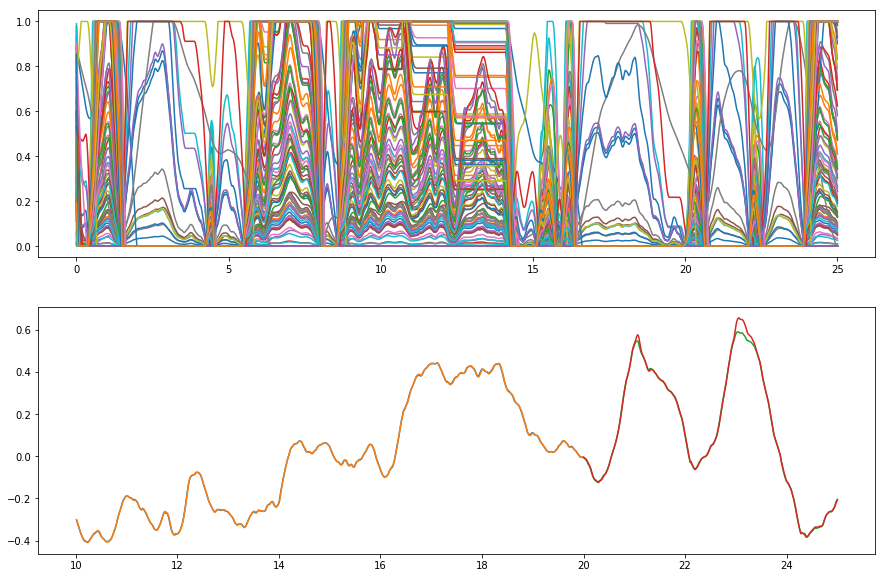

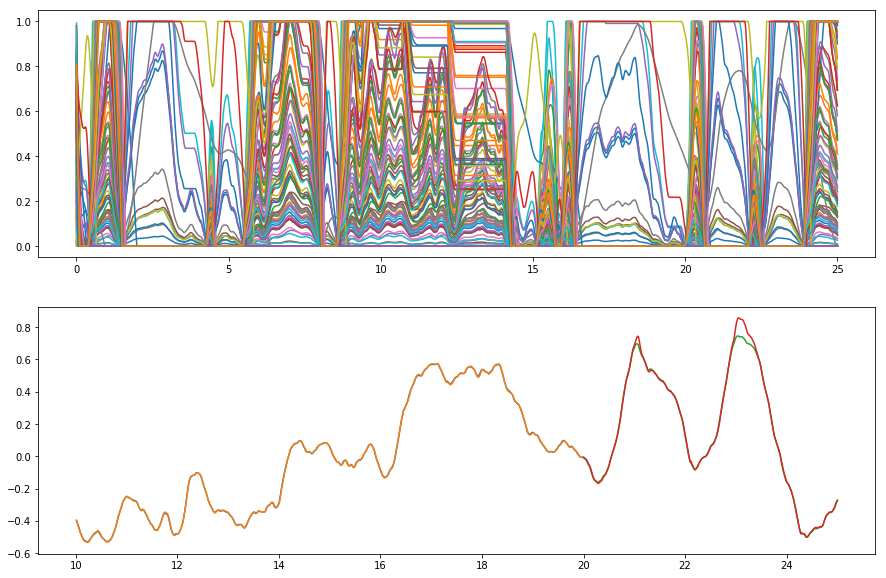

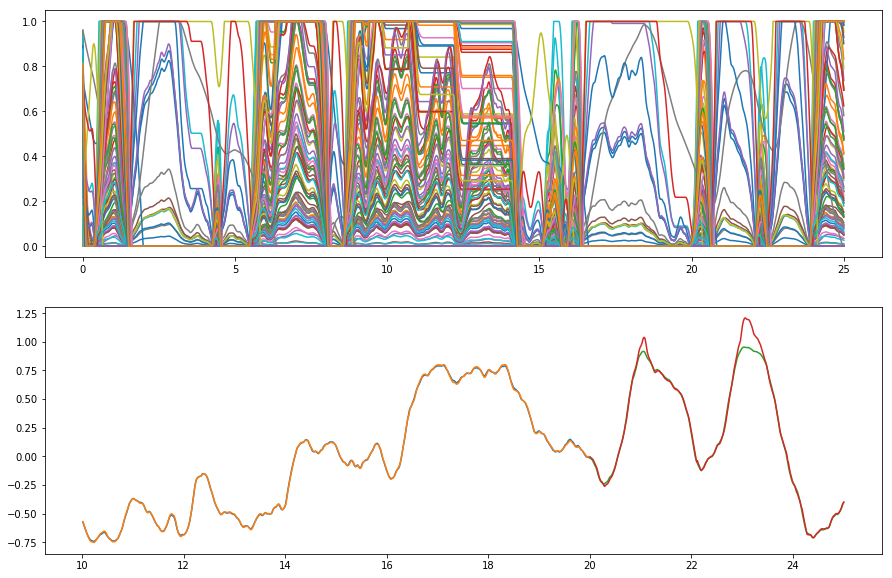

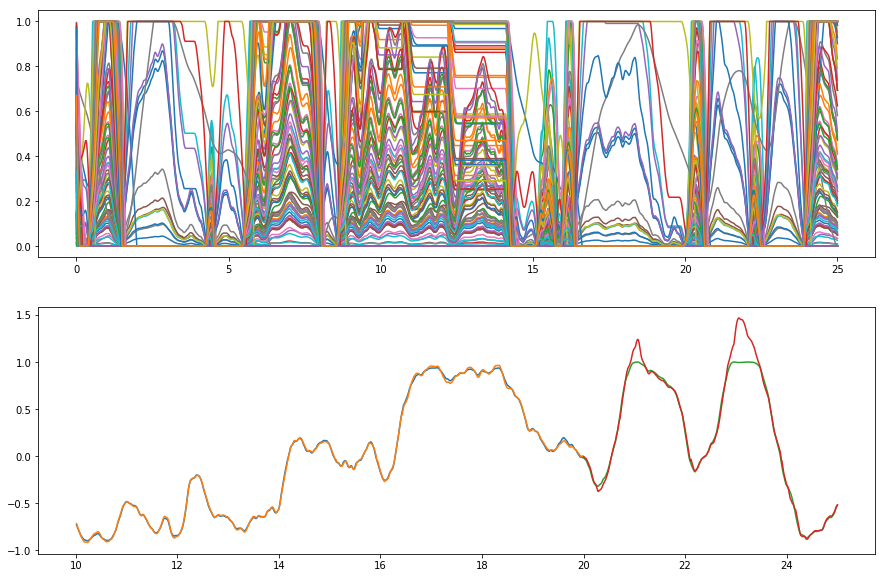

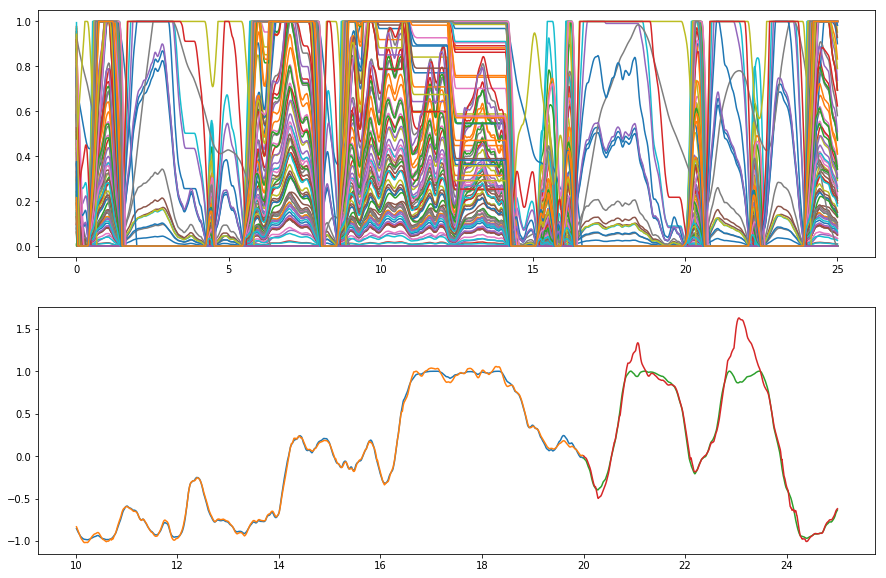

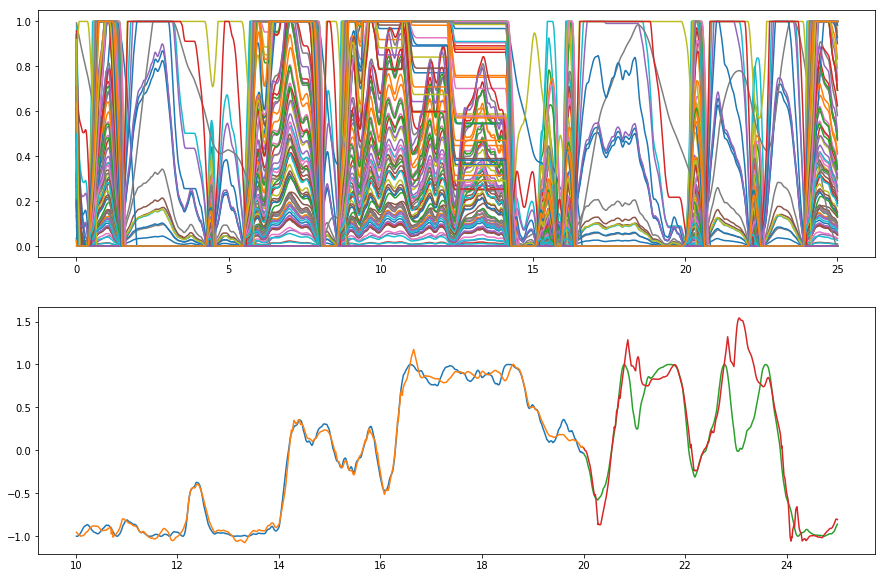

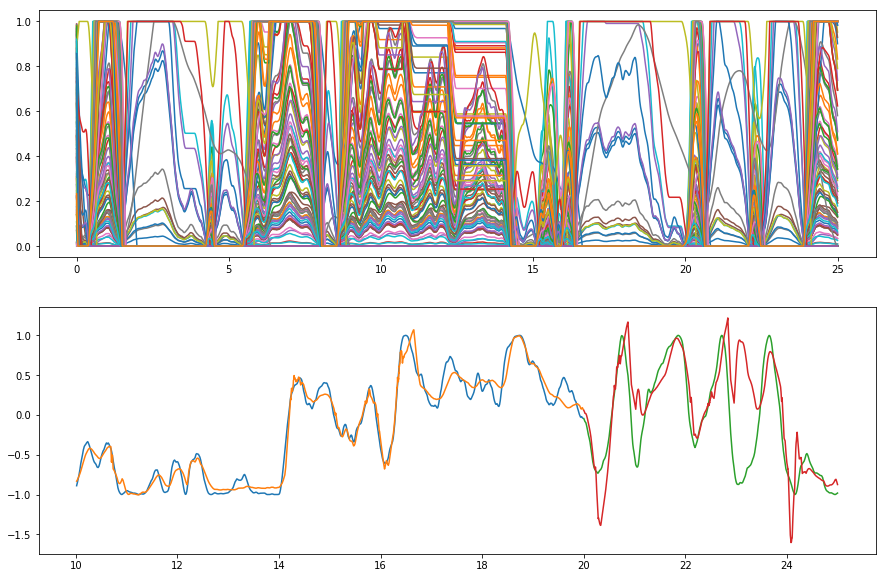

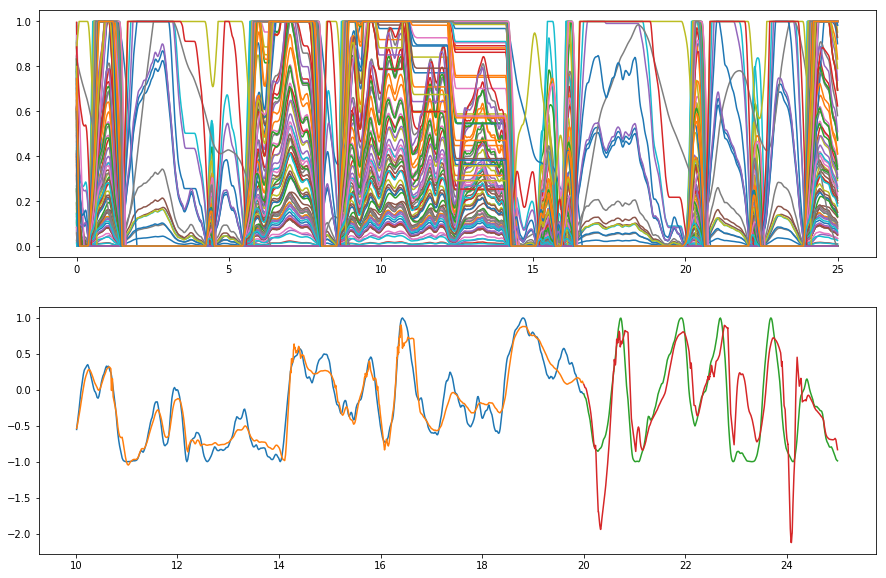

In [62]:
alpha = np.random.exponential(scale=32, size=(m_cubic,))
beta = 0.025
chi = 0.1

freq = [0.1, 0.2, 0.3, 0.4, 0.6, 0.8, 1.0, 1.5, 2., 2.5]
MSE_sin_train = np.zeros_like(freq, dtype='float')
MSE_sin_extrap = np.zeros_like(freq, dtype='float')

for idx, f in enumerate(freq):

    def sin_noise(t):
        return np.sin(f*noise_func(t))

    times, traj, clf, MSE_train, MSE_extrap = train_reservoir(noise_voltage_source_cubic, 
                                            sin_noise, OmegaA_cubic, alpha, beta, chi)
    
    MSE_sin_train[idx] = MSE_train
    MSE_sin_extrap[idx] = MSE_extrap
    
np.savez('Noise_sin_reconstruction_chi.1.npz', freq=freq, MSE_sin_train=MSE_sin_train, MSE_sin_extrap=MSE_sin_extrap)

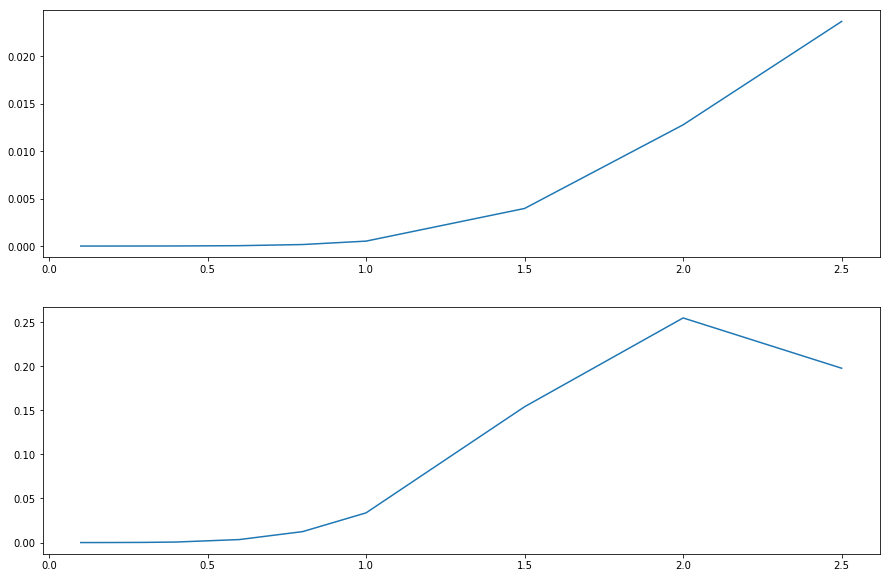

In [63]:
files = np.load('Noise_sin_reconstruction_chi.1.npz')

delays = files['freq']
MSE_delays_train = files['MSE_sin_train']
MSE_delays_extrap = files['MSE_sin_extrap']

fig, ax = plt.subplots(2, 1, figsize=(15, 10))

ax[0].plot(delays, MSE_delays_train)

ax[1].plot(delays, MSE_delays_extrap)

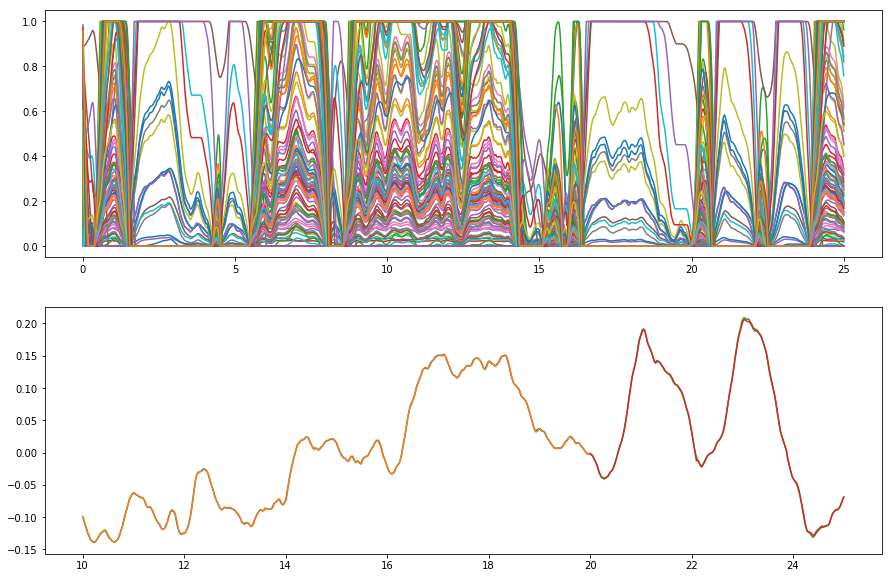

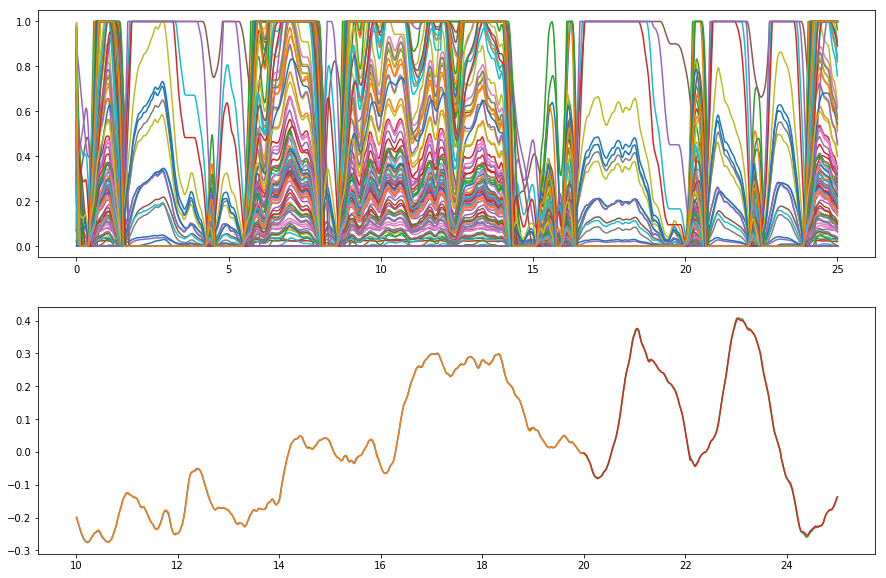

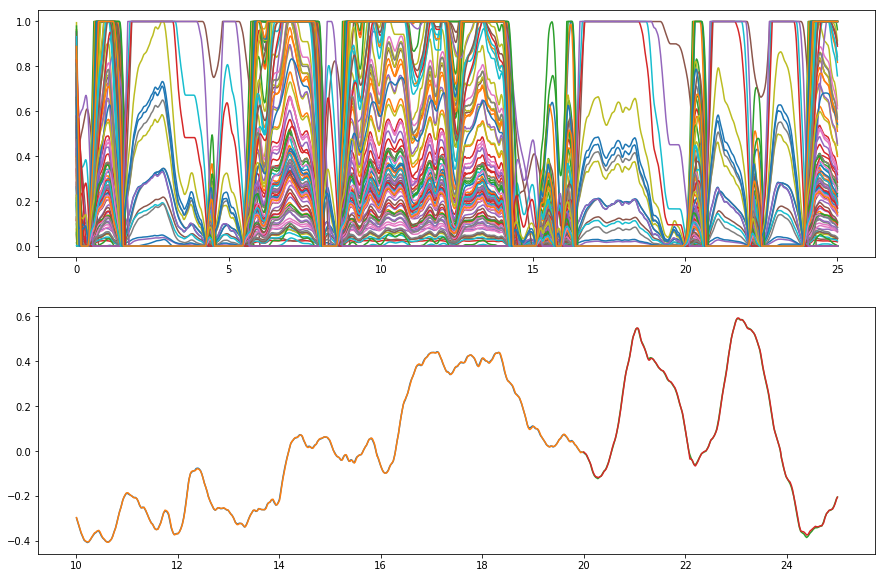

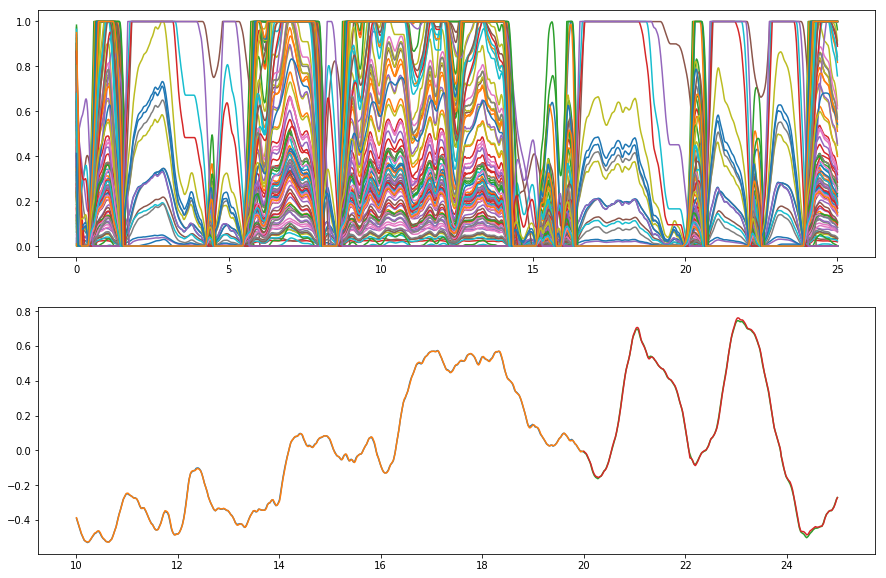

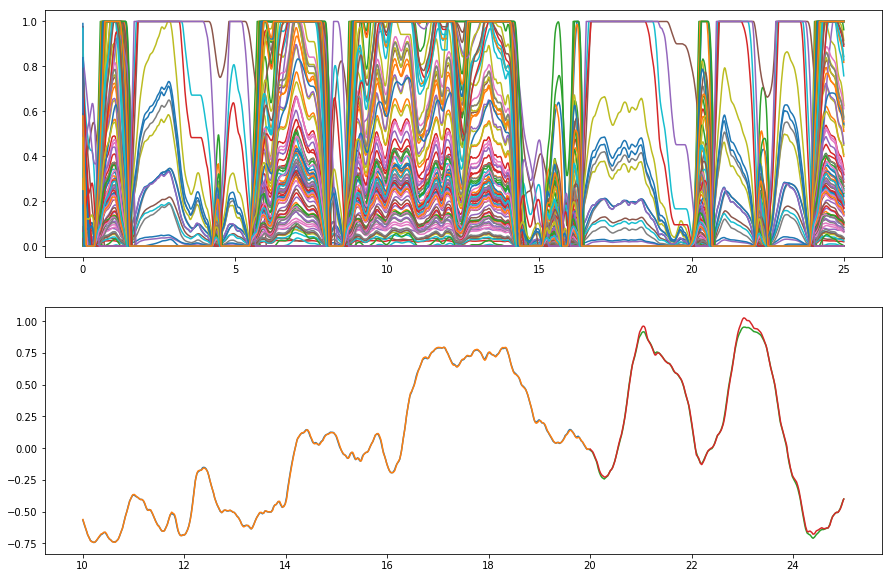

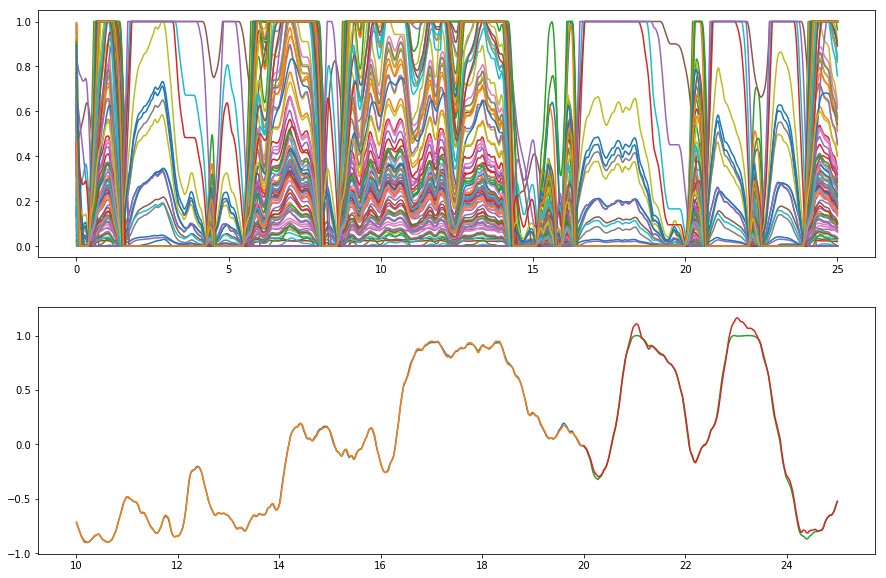

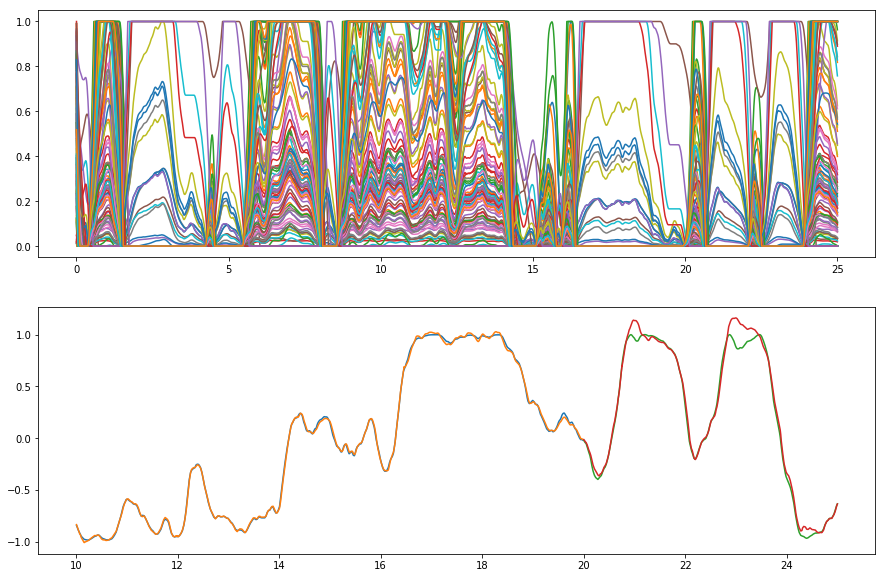

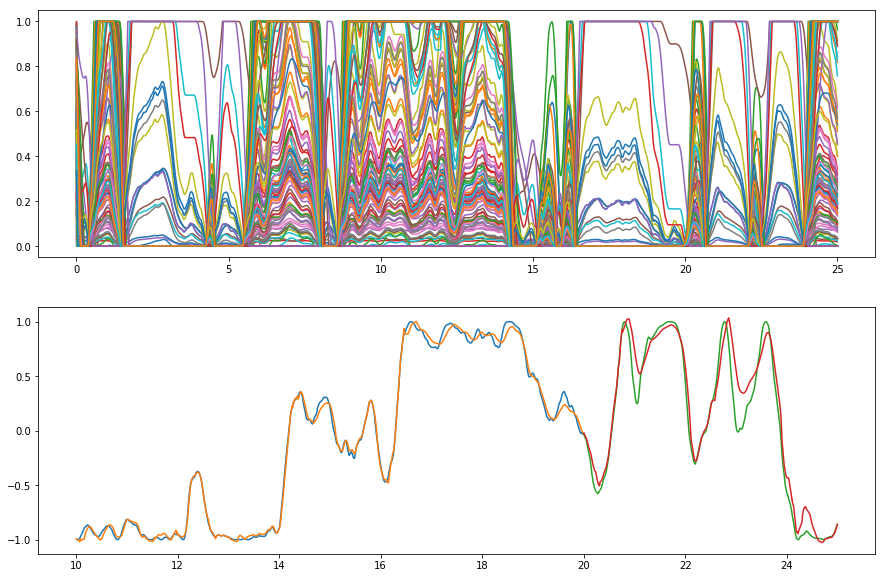

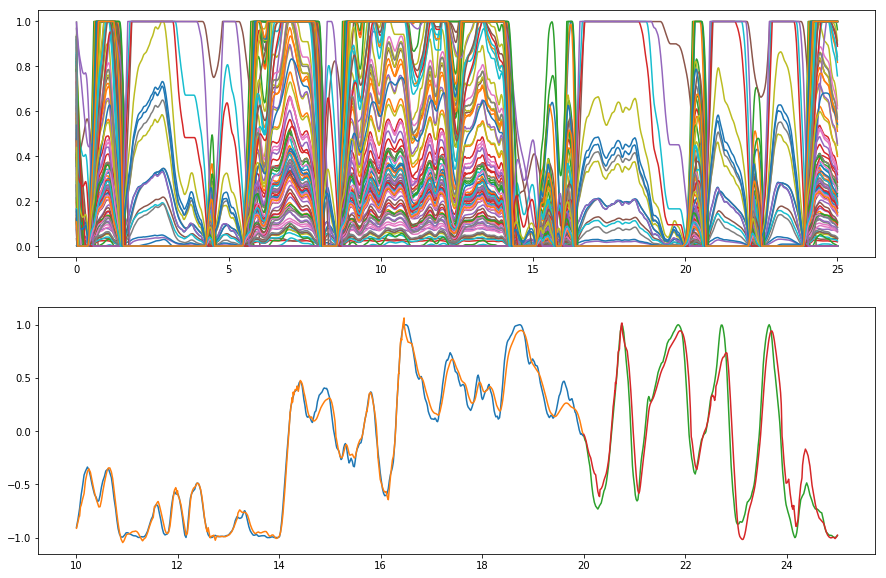

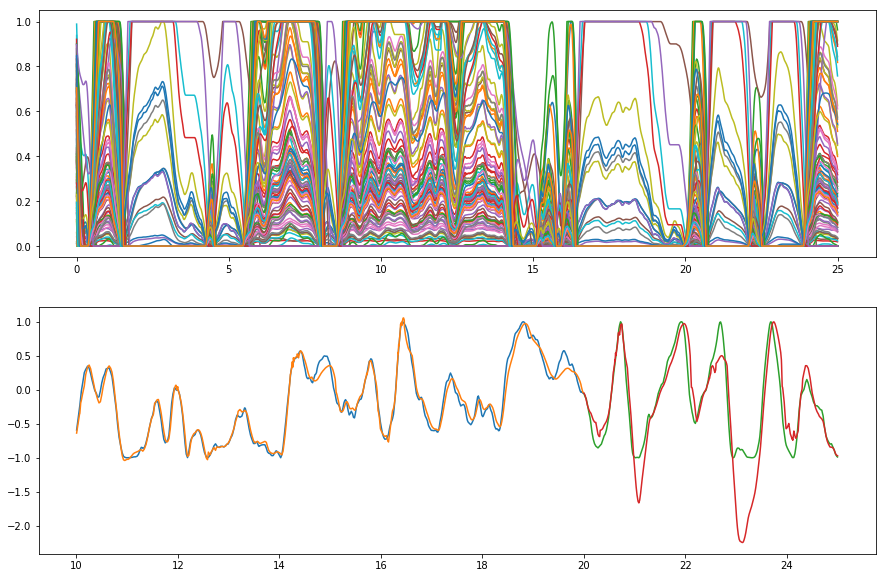

In [64]:
alpha = np.random.exponential(scale=32, size=(m_cubic,))
beta = 0.025
chi = 0.9

freq = [0.1, 0.2, 0.3, 0.4, 0.6, 0.8, 1.0, 1.5, 2., 2.5]
MSE_sin_train = np.zeros_like(freq, dtype='float')
MSE_sin_extrap = np.zeros_like(freq, dtype='float')

for idx, f in enumerate(freq):

    def sin_noise(t):
        return np.sin(f*noise_func(t))

    times, traj, clf, MSE_train, MSE_extrap = train_reservoir(noise_voltage_source_cubic, 
                                            sin_noise, OmegaA_cubic, alpha, beta, chi)
    
    MSE_sin_train[idx] = MSE_train
    MSE_sin_extrap[idx] = MSE_extrap
    
np.savez('Noise_sin_reconstruction_chi.9.npz', freq=freq, MSE_sin_train=MSE_sin_train, MSE_sin_extrap=MSE_sin_extrap)

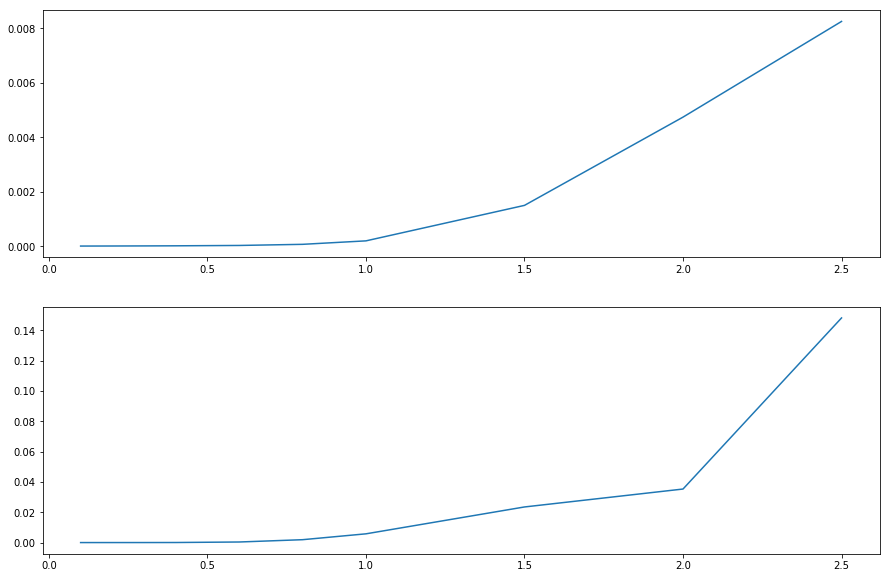

In [65]:
files = np.load('Noise_sin_reconstruction_chi.9.npz')

delays = files['freq']
MSE_delays_train = files['MSE_sin_train']
MSE_delays_extrap = files['MSE_sin_extrap']

fig, ax = plt.subplots(2, 1, figsize=(15, 10))

ax[0].plot(delays, MSE_delays_train)

ax[1].plot(delays, MSE_delays_extrap)

### Tuning Nonlinear Reconstruction